# Experiment Documentation: Identification in N:M Search Spaces

This experiment investigates the dynamics of feature correspondences within an N:M matching framework, leveraging comparisons between original and transformed images. The evaluation considers three detectors: our method, REKD, and KeyNet, alongside two established descriptors: SIFT and HardNet. The study focuses on understanding the interplay between these components and their influence on image identification across datasets of varying complexity: Flowers, Woods, and UV Fibers from Banknotes.

## Methodology

To ensure comprehensive analysis, an **N:M matching process** is applied to evaluate feature correspondences. The selected datasets present progressively increasing challenges:

**Flowers**: Patterns characterized by repetition and detail.

**Woods**: A blend of structural and textural features.

**UV Fibers from Banknotes**: Complex micro-patterns with high forensic relevance.

This methodology facilitates a granular assessment of the robustness and reliability of detector-descriptor combinations under diverse conditions.

## Objective

The objective of this experiment is to analyze how the careful selection of robust keypoints and descriptors enhances the efficacy of image identification pipelines. By addressing the challenges posed by datasets of escalating complexity, this study offers critical insights into optimizing detection and matching strategies for advanced real-world applications.

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import kornia.feature as KF
import kornia as K

def visualize_matching_images(img1, LAF1, img2, LAF2, matches):
    print(LAF1.shape,LAF2.shape)
    x1, y1 = KF.laf.get_laf_pts_to_draw(LAF1, 0)  # Pontos da primeira imagem
    x2, y2 = KF.laf.get_laf_pts_to_draw(LAF2, 0)  # Pontos da segunda imagem

    # Converte as listas x2 e y2 em arrays NumPy
    x2 = np.array(x2)
    y2 = np.array(y2)

    # Crie uma imagem combinada concatenando as duas imagens lado a lado
    combined_image = np.concatenate((K.utils.tensor_to_image(img1), K.utils.tensor_to_image(img2)), axis=1)

    fig, ax = plt.subplots(1, 1, figsize=(12, 6))  # Cria uma figura com uma subplot

    # Plota a imagem combinada
    ax.imshow(combined_image)
    ax.axis('off')
    # Plota os pontos correspondentes nas duas imagens
    ax.plot(x1, y1, 'c')  # 'ro' representa pontos vermelhos na primeira imagem
    ax.plot(x2 + img1.shape[1], y2, 'y')  # Desloca os pontos azuis na segunda imagem para a direita

    points1 =K.feature.get_laf_center(LAF1)[0].cpu()
    points2 =K.feature.get_laf_center(LAF2)[0].cpu()
    print(points1.shape,points2.shape)
    for match in matches:
        x1_match, y1_match = points1[match[0],0], points1[match[0],1]
        x2_match, y2_match = points2[match[1],0] + img1.shape[1], points2[match[1],1]
       
        ax.plot([x1_match, x2_match], [y1_match, y2_match], '-', color='red', lw=1.5)

    plt.tight_layout()
    plt.show()


In [ ]:
import torch
import numpy as np
import kornia
from kornia.feature import DescriptorMatcher
from visidex.utils import evaluate_matches,generate_metrics_output
class LocalComparisonPipeline:
    """
    Compara imagens de inspeção e referência usando características locais e correspondência de descritores.
    """
    def __init__(self, local_feature, descriptor_matcher):
        self.local_feature = local_feature
        self.descriptor_matcher = descriptor_matcher
        print("Local feature extractor:", type(local_feature))
        print("CONFIG",local_feature.config)

    def run(self, inspection_images: torch.Tensor, reference_images: torch.Tensor) -> np.ndarray:
        """
        Compara imagens de inspeção e referência e retorna uma matriz de pontuação baseada em correspondências de descritores.
        """
        n, m = inspection_images.shape[0], reference_images.shape[0]
        scores = np.zeros((n, m))
        cache_reference = {}

        for i_index, i_image in enumerate(inspection_images):
            lafs0, _, descriptors0 = self.local_feature(i_image[:1][None])

            for r_index, r_image in enumerate(reference_images):
                if r_index not in cache_reference:
                    lafs1, _, descriptors1 = self.local_feature(r_image[:1][None])
                    cache_reference[r_index] = descriptors1
                descriptors1 = cache_reference[r_index]

                _, matches = self.descriptor_matcher(descriptors0[0], descriptors1[0])
                # visualize_matching_images(i_image, lafs0, r_image, lafs1, matches)
                num_match = matches.shape[0]
                scores[i_index, r_index] = num_match if num_match >= 3 else 0
        
        return scores

    def evaluate_matches(self, matches_matrix, threshold=0.5):        
        return evaluate_matches(matches_matrix, threshold)


In [3]:
import time
from contextlib import contextmanager
from tqdm import tqdm
@contextmanager
def medir_tempo(label: str = "Tempo de execução"):
    """
    Medidor de tempo de execução para blocos de código.

    Parâmetros:
    - label (str): Rótulo a ser exibido com o tempo de execução.
    """
    start = time.perf_counter()
    try:
        yield
    finally:
        end = time.perf_counter()
        print(f"{label}: {end - start} segundos")

In [4]:
import logging
from itertools import product
from visidex.utils import set_seed, check_and_clear_memory,AugmentationGenerator,print_results_table

import torch
import kornia as K
from visidex.model import read_dataload_woods,read_dataload_fibers,read_dataload_flower
from visidex.kornia_local_feature import KeyNetFeatureSIFT,KeyNetFeatureSosNet,REKDSosNet,SingularPointSosNet,REKDHardNet, SingularPointHardNet
from utils.TensorImgIO import imshow_points
import warnings
warnings.filterwarnings("ignore")

# Logger específico
logger = logging.getLogger("Main")  # Logger para a execução principal
logger.setLevel(logging.INFO)  # Define o nível de log como INFO

def grid_search_pipeline(device, dataset_loader,aug_gen, param_grid):
    all_results = []
    for num_features, feature_local_class, distance, threshold in product(*param_grid.values()):
        set_seed(1)# TODO Tem isso no global/local
        # Configuração específica do extrator de features com a classe e número de features
        feature_extractor = feature_local_class(num_features, device=device)
        SUM_MTP, SUM_MFP, SUM_MFN, SUM_MTN = 0, 0, 0, 0
        # Configurar a pipeline com os parâmetros atuais
        local_feature = feature_local_class(num_features=num_features, device=device).to(device).eval()
        descriptor_matcher = DescriptorMatcher(match_mode="snn", th=distance).to(device).eval()  # Usando o matcher SNN
        pipeline = LocalComparisonPipeline(
            local_feature=local_feature,
            descriptor_matcher=descriptor_matcher
        )

        # Executar a pipeline e registrar resultados para o batch atual
        with medir_tempo():
            with torch.no_grad():
                # Informações para exibir na barra de carregamento
                params_str = f"Num Features: {num_features}, Class: {feature_local_class.__name__}, Distance: {distance}, Threshold: {threshold}"
                # Use tqdm para criar a barra de carregamento
                for batch_idx, (original_batch, target) in tqdm(enumerate(dataset_loader),
                                                                total=len(dataset_loader),
                                                                desc=params_str,
                                                                leave=False,
                                                                unit="batch"):
                    original_batch = original_batch.to(device)
                    referencia_batch, remaining_batch = torch.split(original_batch, original_batch.size(0) // 2, dim=0)
                    
                    params_item = next(aug_gen)
                    inspection_images =aug_gen.augmentation_sequence(original_batch,params=params_item)

                    scores = pipeline.run(inspection_images, referencia_batch)
                    M = pipeline.evaluate_matches(scores,threshold=threshold)
 
                    # Acumula os resultados de TP, FP e FN
                    SUM_MTP, SUM_MFP, SUM_MFN, SUM_MTN = [x + y for x, y in zip((SUM_MTP, SUM_MFP, SUM_MFN, SUM_MTN), M)]

        check_and_clear_memory()                
        aug_gen.reset()# //TODO: reiniciar o gerador de transformacoes
        result = {
            'params': {
                'num_features': num_features,
                'feature_local_class': feature_local_class.__name__,
                'distance': distance,
                'threshold': threshold
            },
            'matches': {
                'TP': SUM_MTP,'FN': SUM_MFN,'TN': SUM_MTN,'FP': SUM_MFP
            }
        }
        
        logger.info(generate_metrics_output(TP=SUM_MTP, FP=SUM_MFP, FN=SUM_MFN, TN=SUM_MTN))
        all_results.append(result)
    return all_results

INFO:Main:Dispositivo: cuda


6072


INFO:Main:Total de elementos no dataset: 6072 total batch: 46


artifact already exists at ./models/singular-0.0.1.pth. Skipping download.
Loading model weights from ./models/singular-0.0.1.pth ...
Model loaded successfully.


Downloading: "https://github.com/yuruntian/SOSNet/raw/master/sosnet-weights/sosnet_32x32_liberty.pth" to /home/wagner/.cache/torch/hub/checkpoints/sosnet_32x32_liberty.pth
100%|██████████| 5.10M/5.10M [00:01<00:00, 3.09MB/s]


artifact already exists at ./models/singular-0.0.1.pth. Skipping download.
Loading model weights from ./models/singular-0.0.1.pth ...
Model loaded successfully.
Local feature extractor: <class 'visidex.kornia_local_feature.local_feature_custons.SingularPointSosNet'>
CONFIG {'num_filters': 8, 'num_levels': 3, 'kernel_size': 5, 'Detector_conf': {'nms_size': 5, 'pyramid_levels': 0, 'up_levels': 0, 'scale_factor_levels': 1.3, 's_mult': 12.0}}


Num Features: 60, Class: SingularPointSosNet, Distance: 0.9, Threshold: 6:   0%|          | 0/46 [00:00<?, ?batch/s]

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


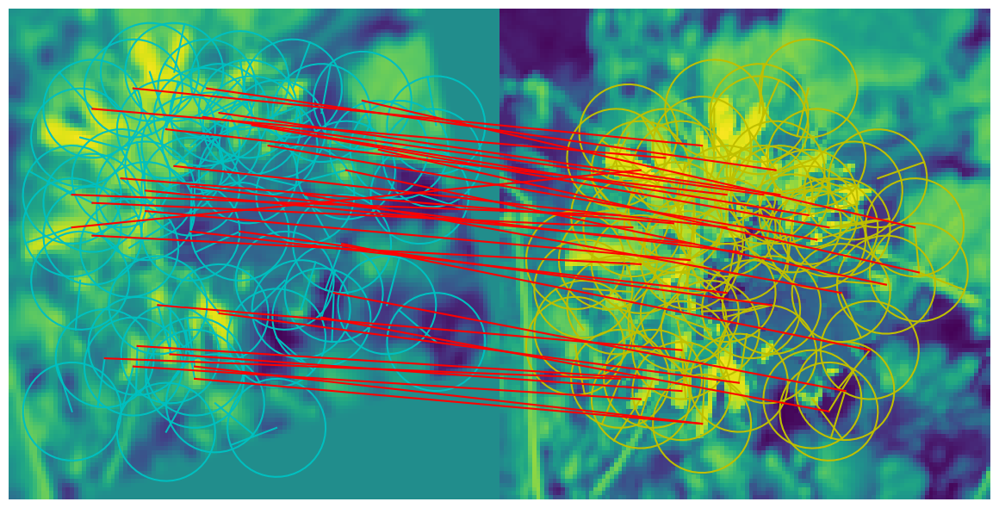

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


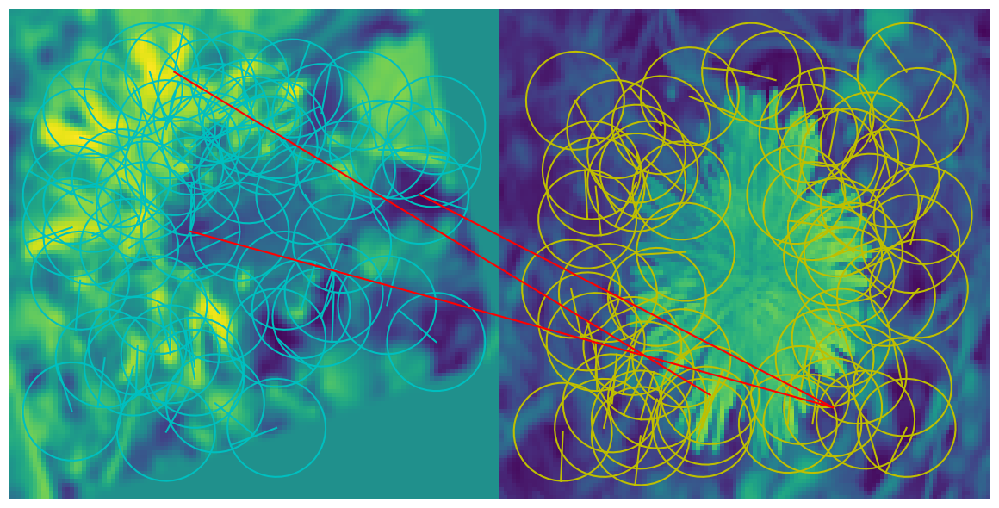

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


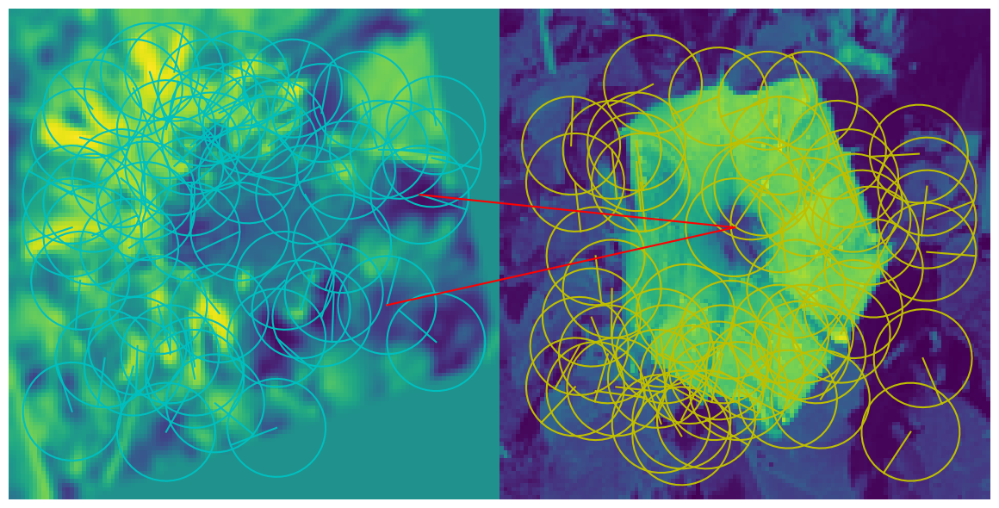

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


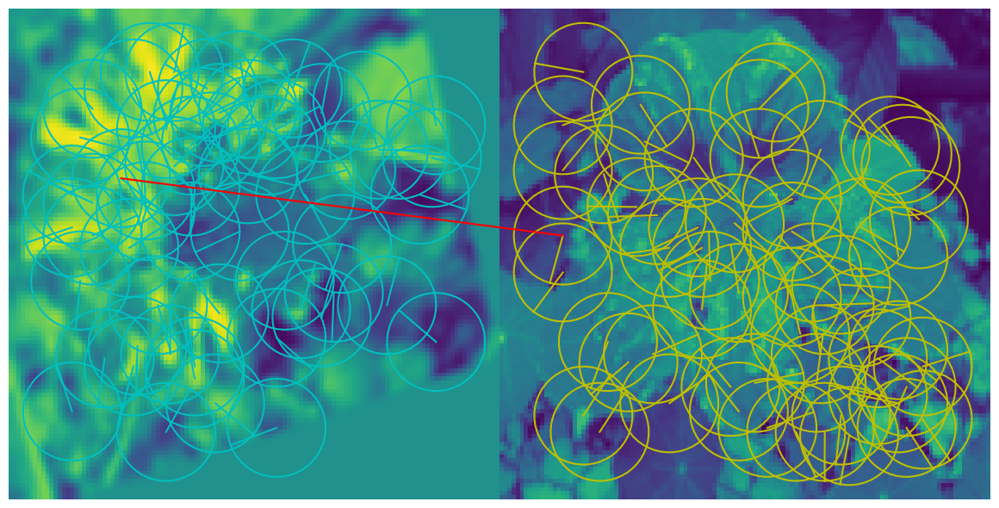

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


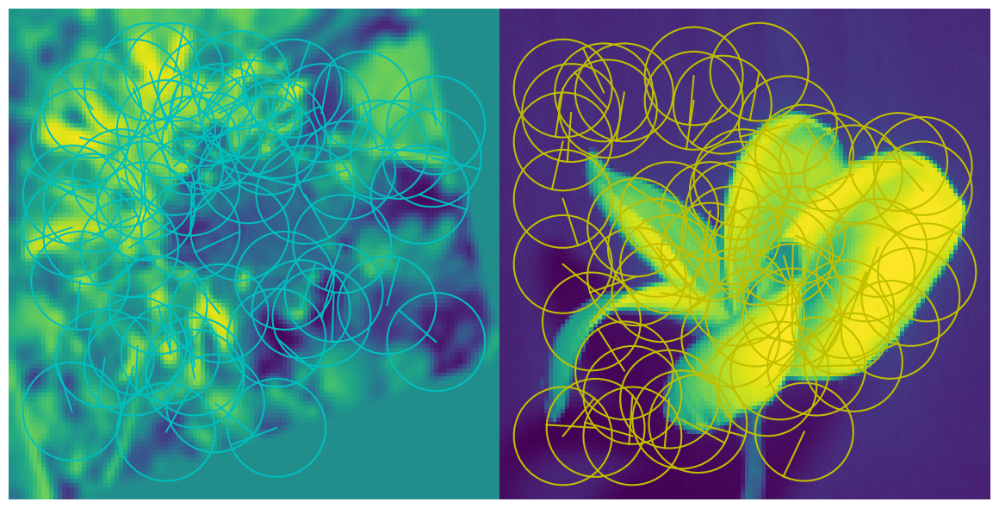

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


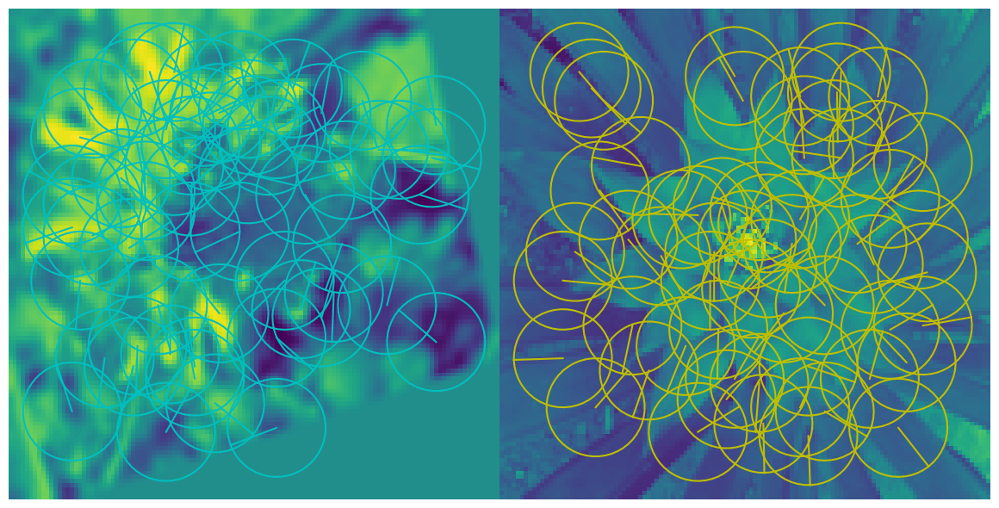

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


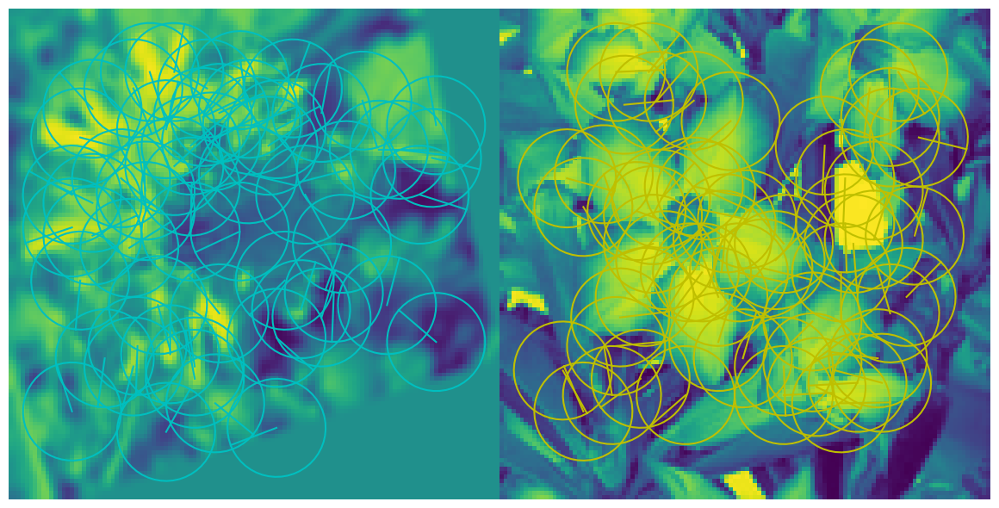

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


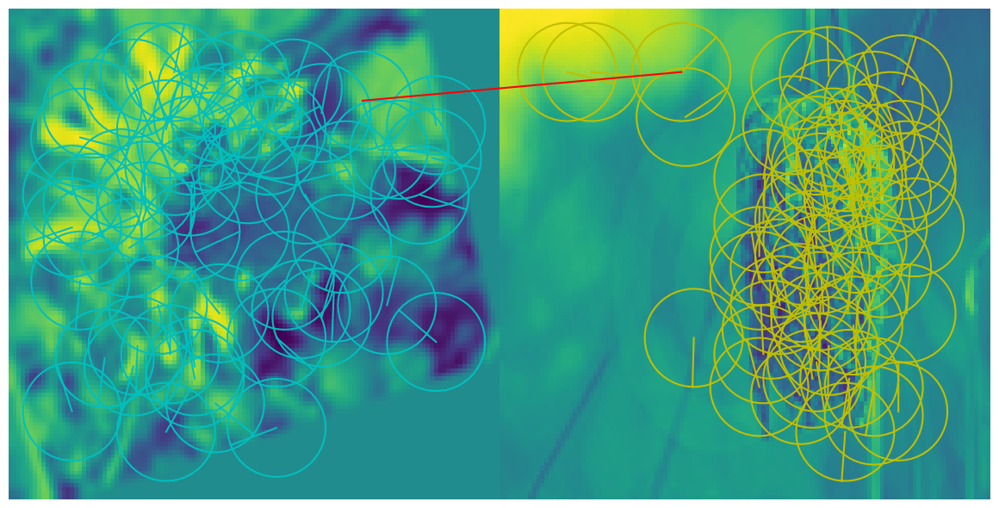

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


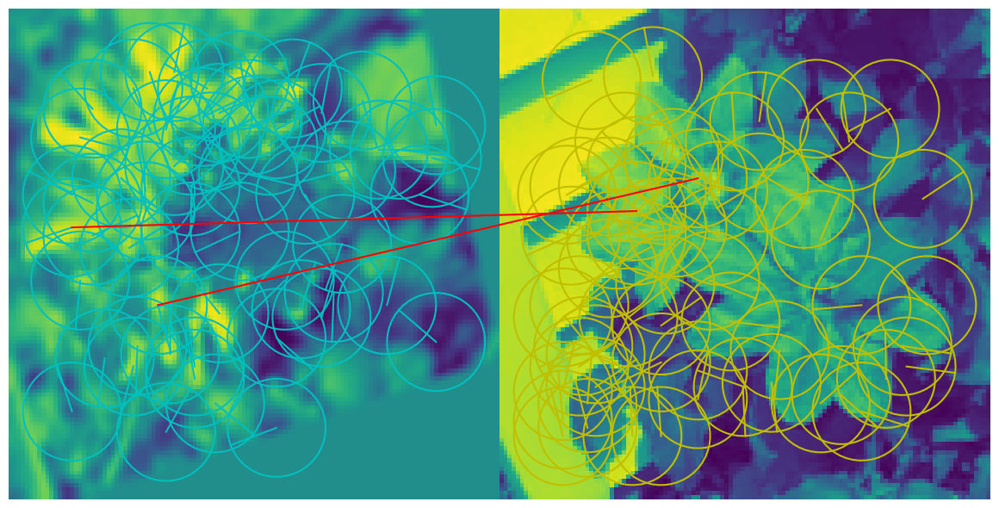

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


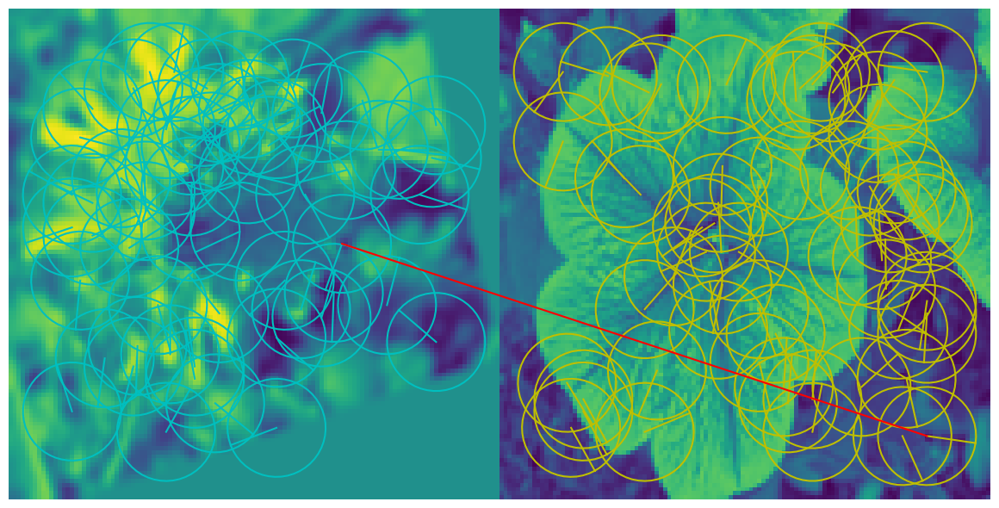

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


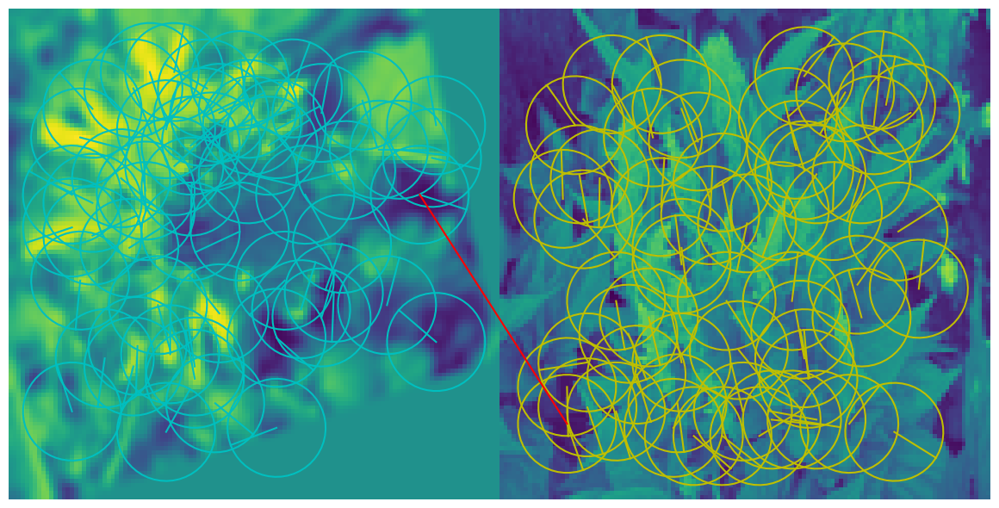

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


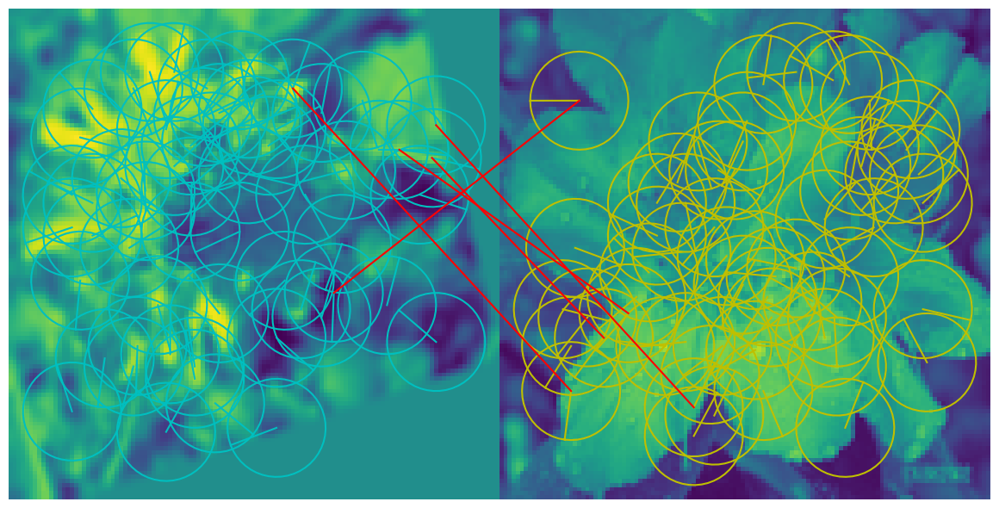

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


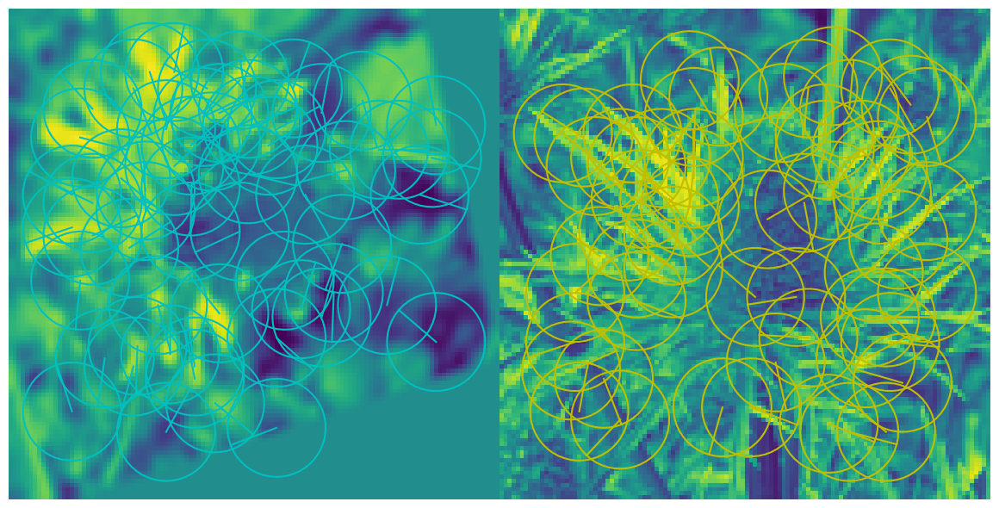

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


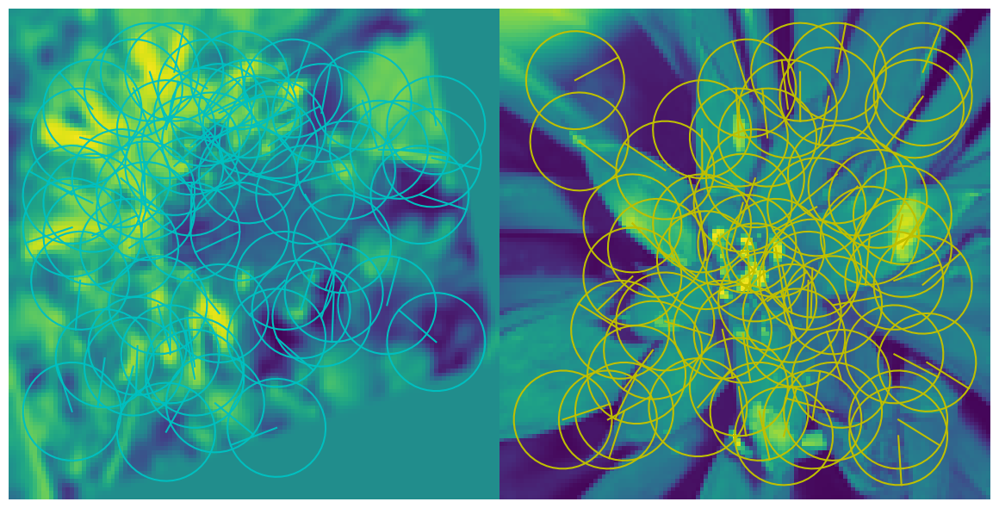

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


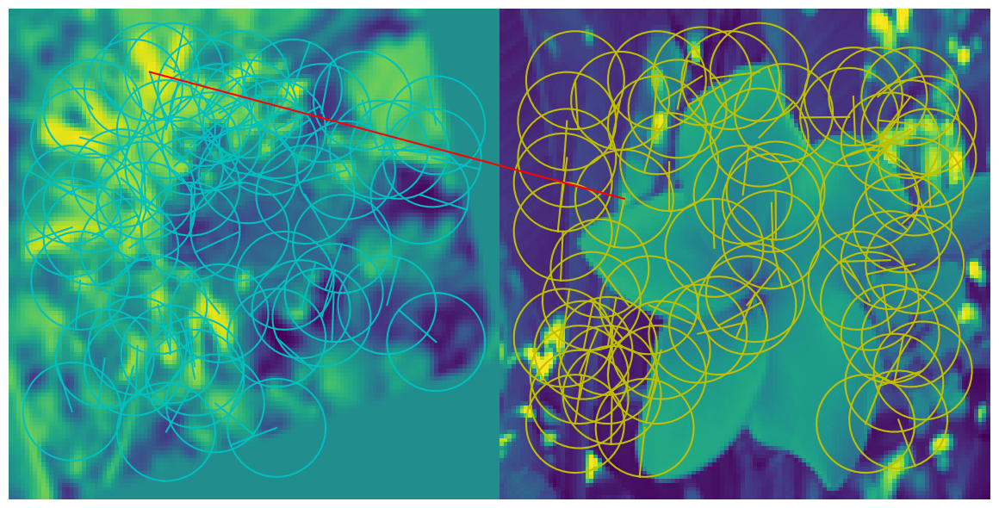

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


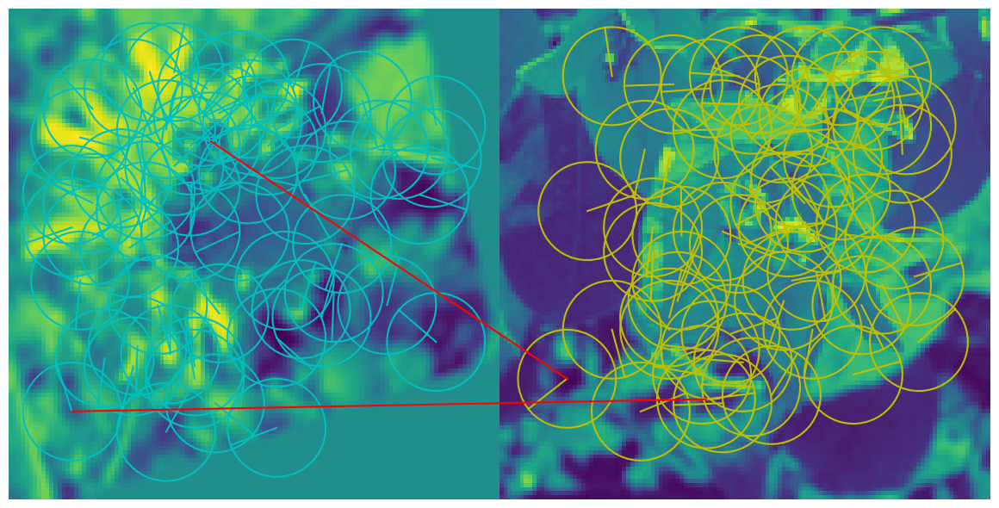

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


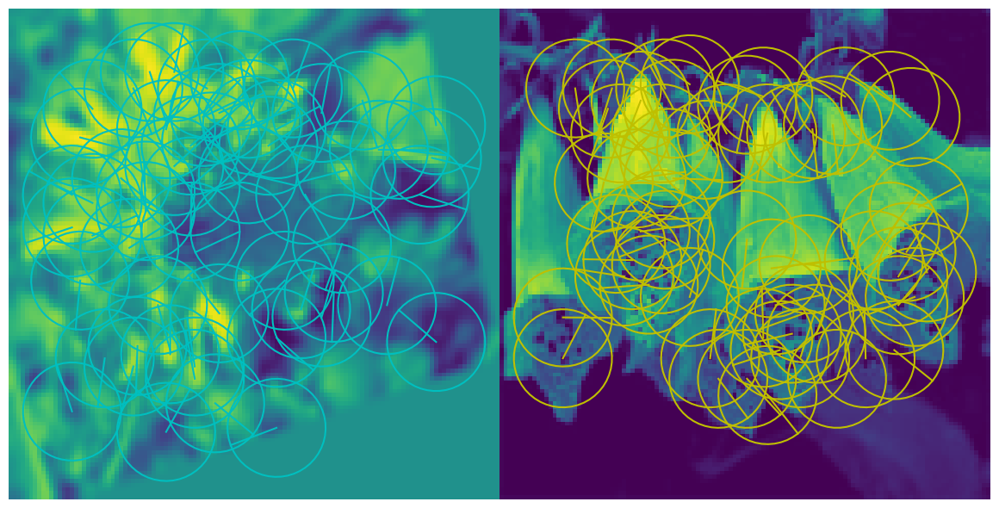

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


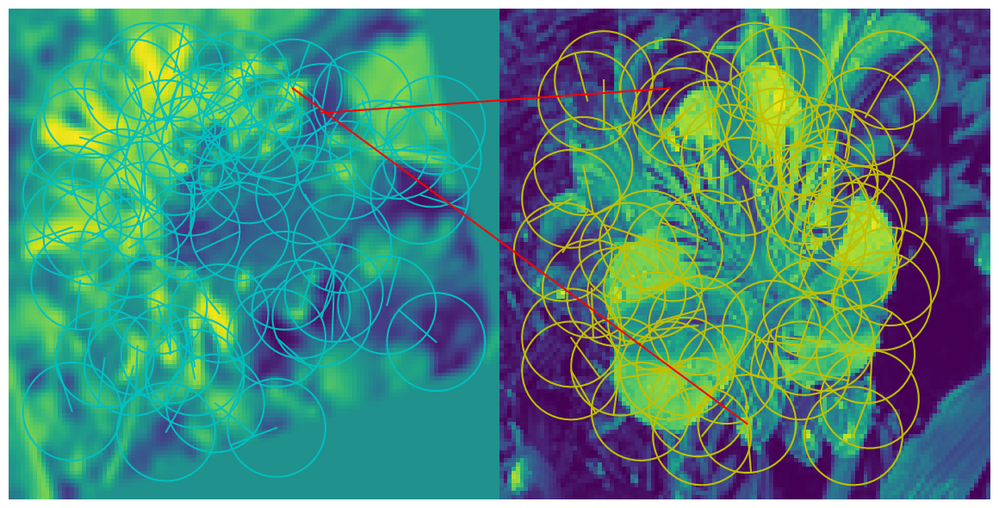

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


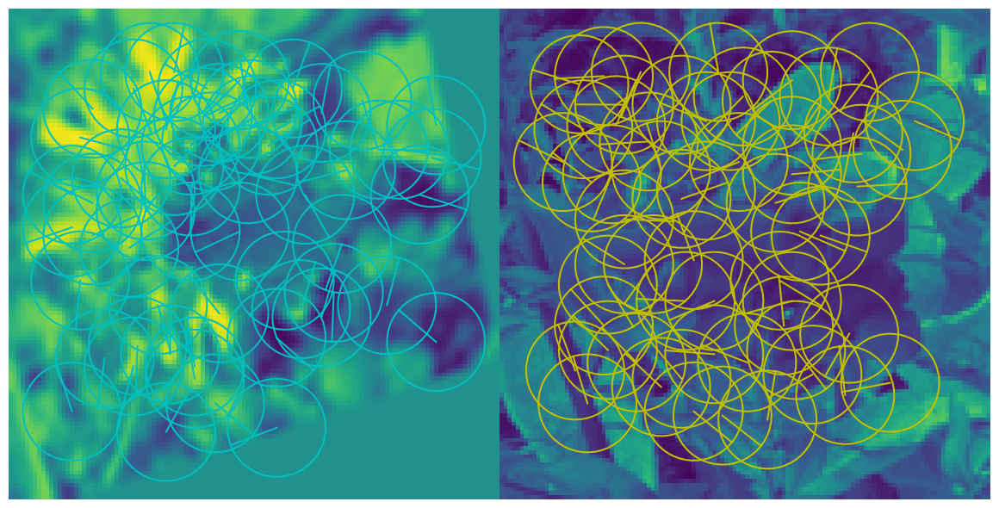

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


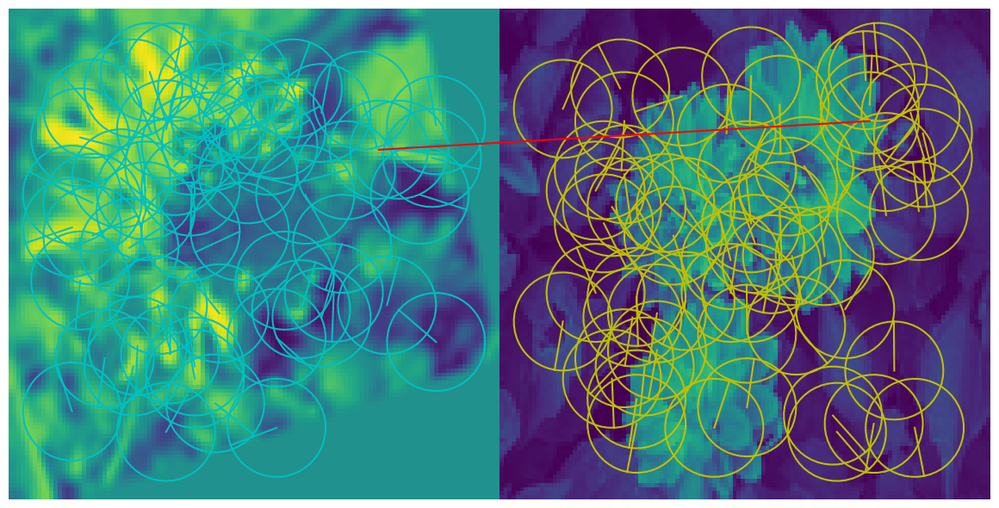

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


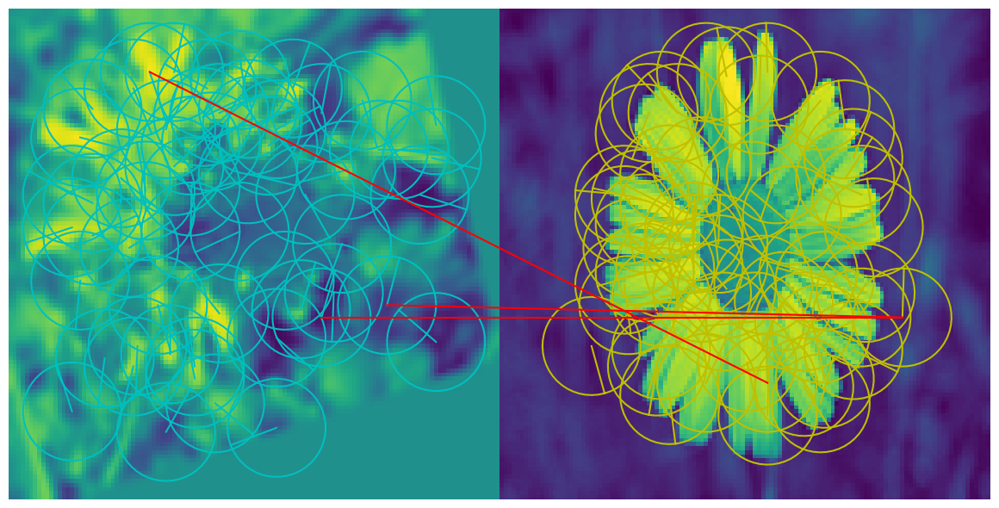

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


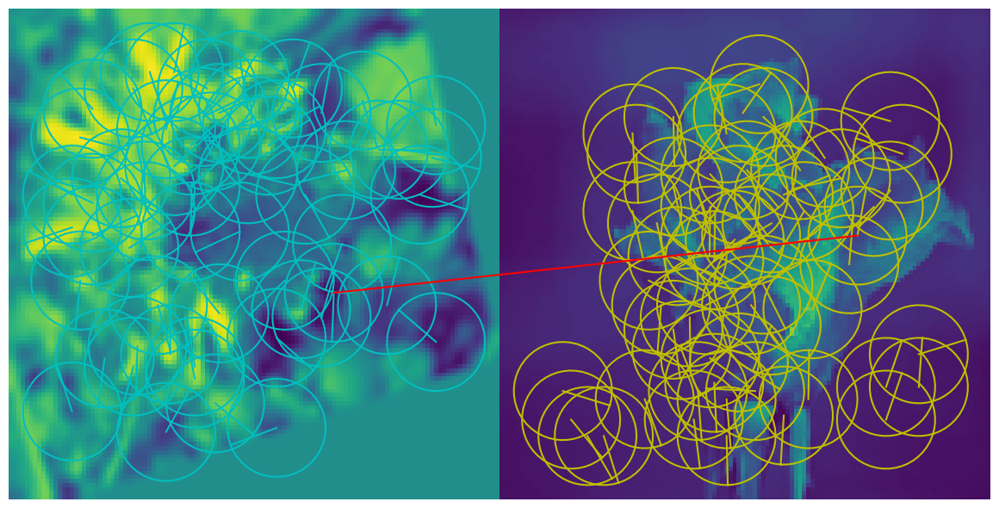

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


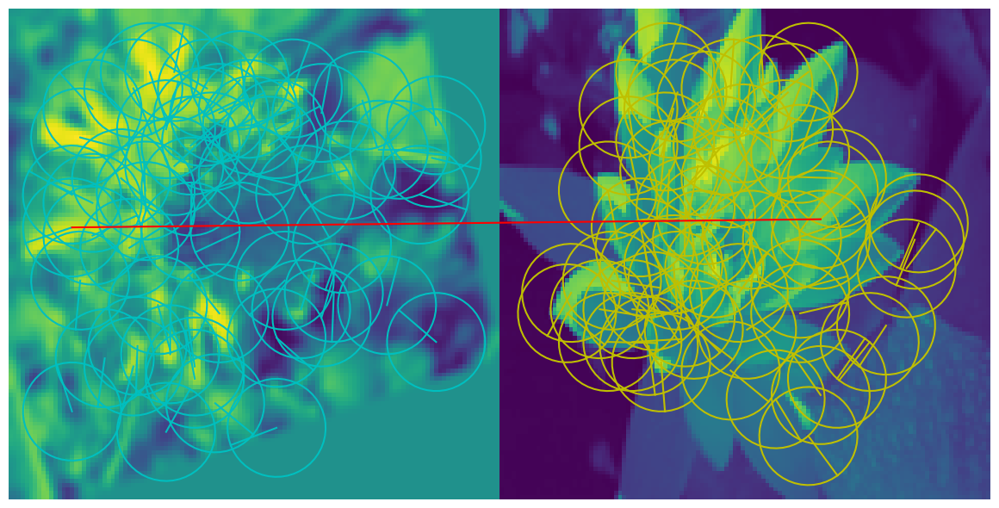

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


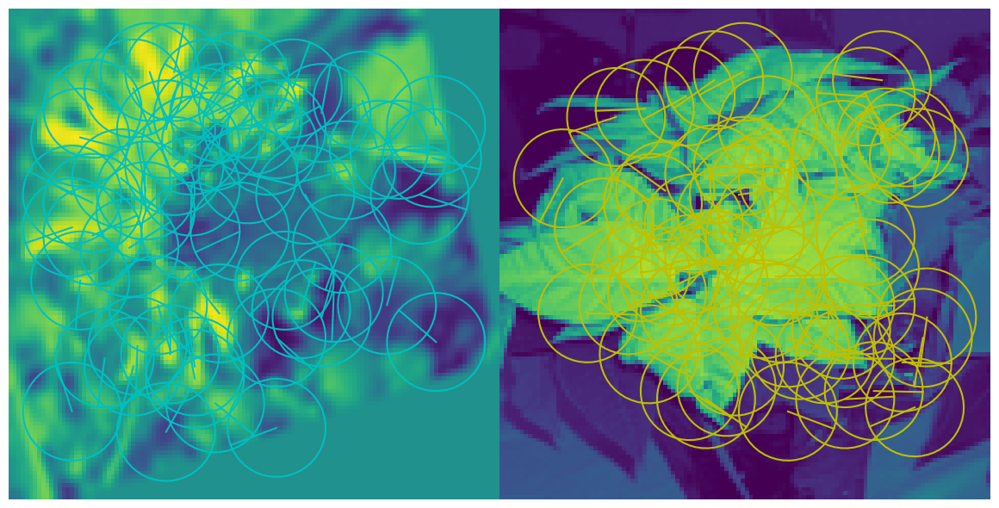

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


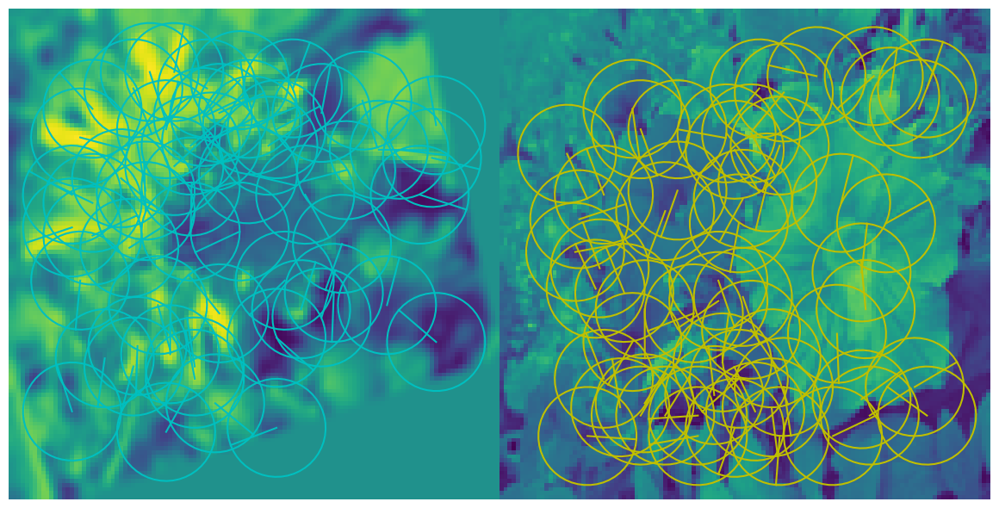

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


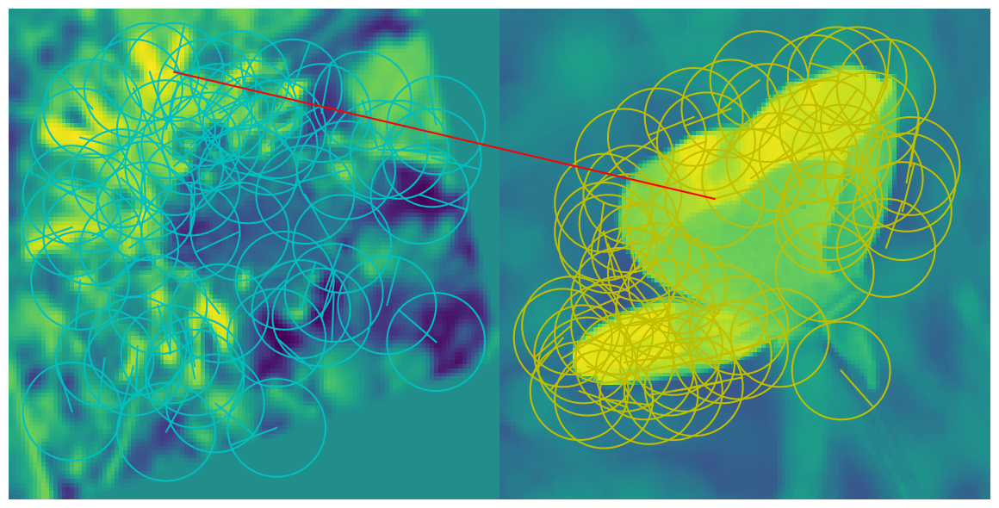

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


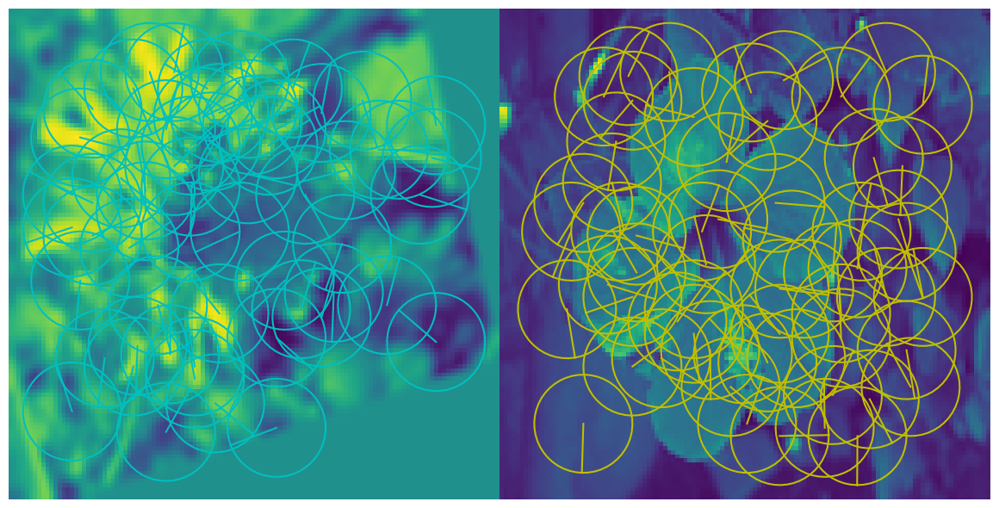

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


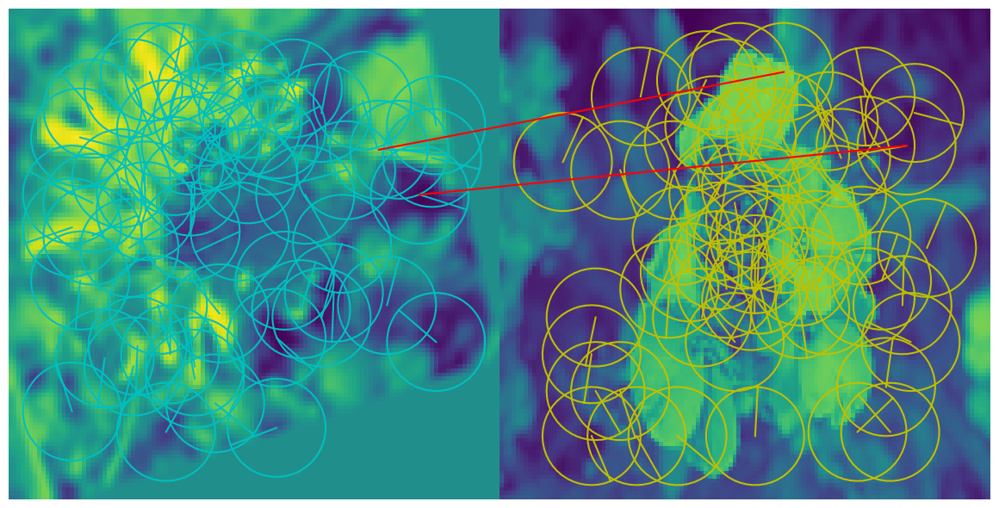

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


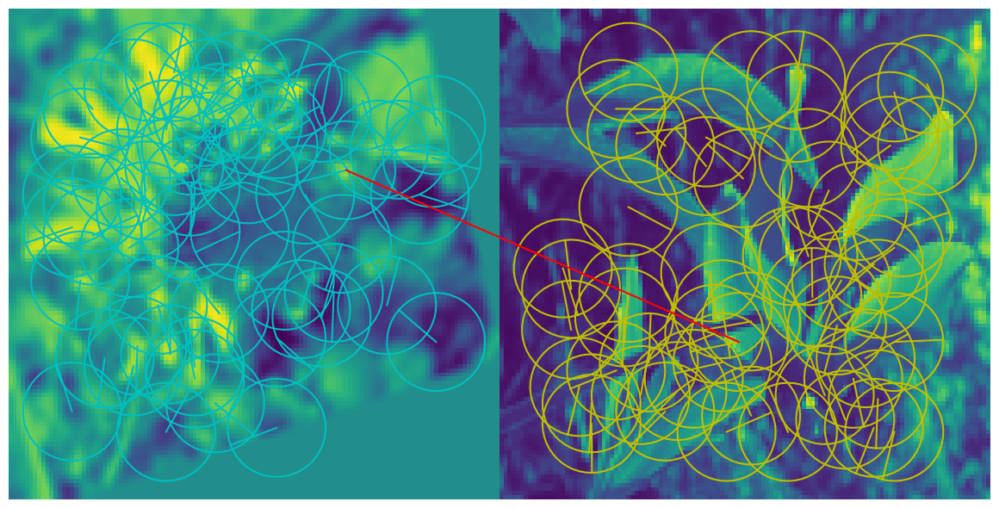

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


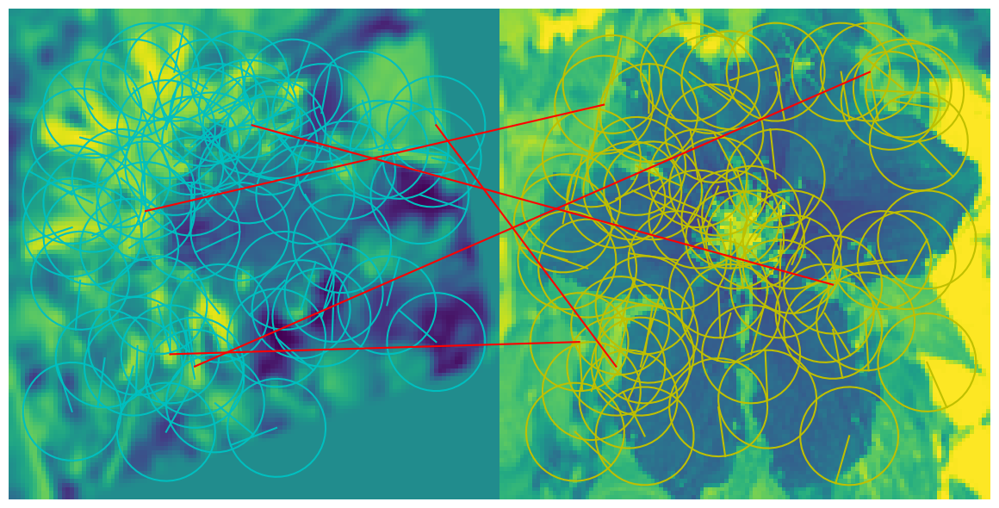

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


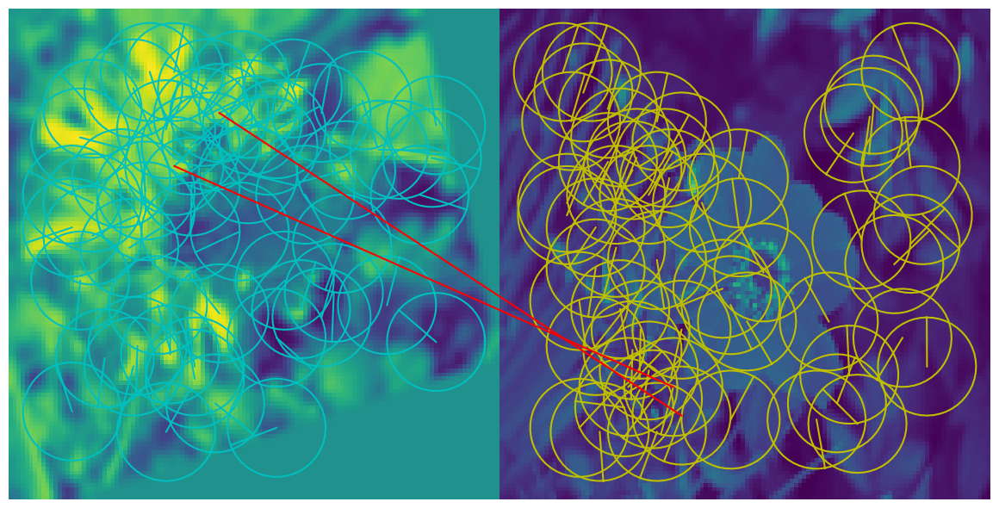

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


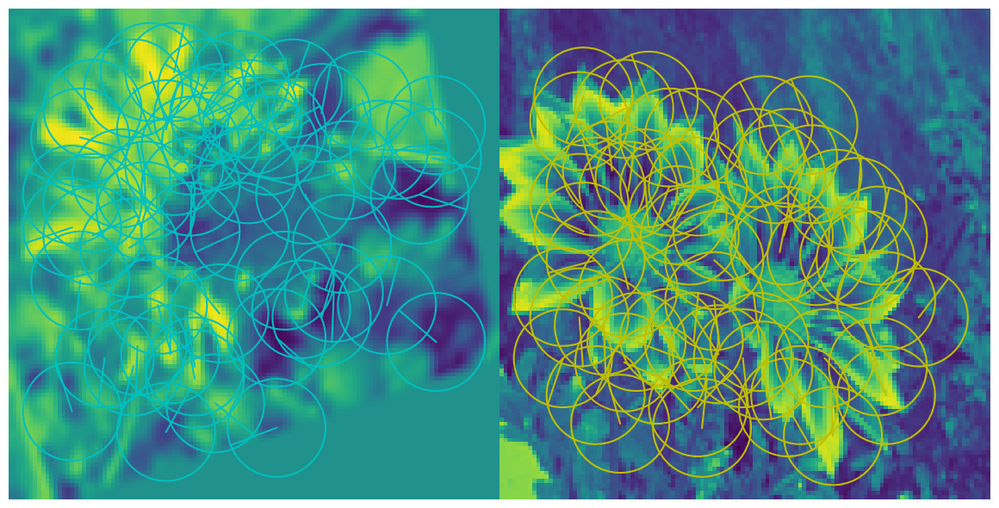

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


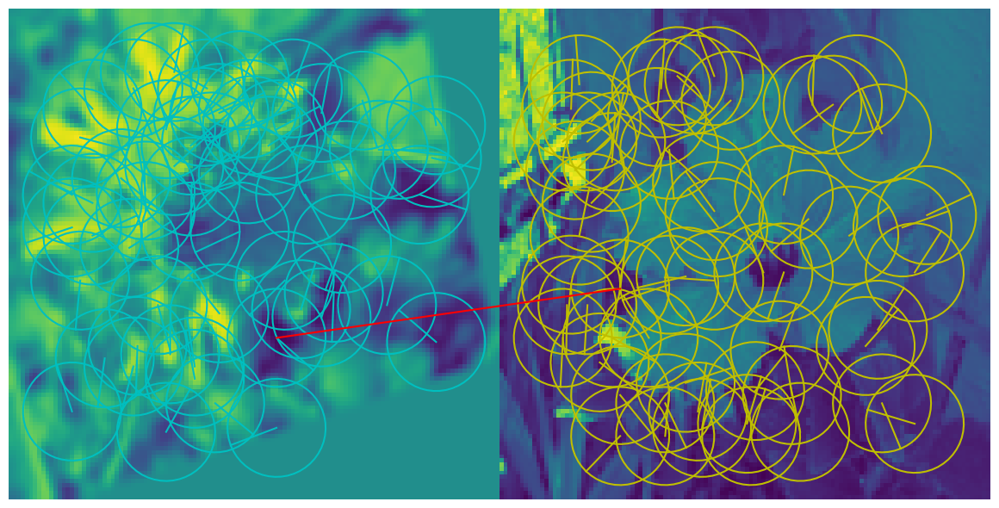

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


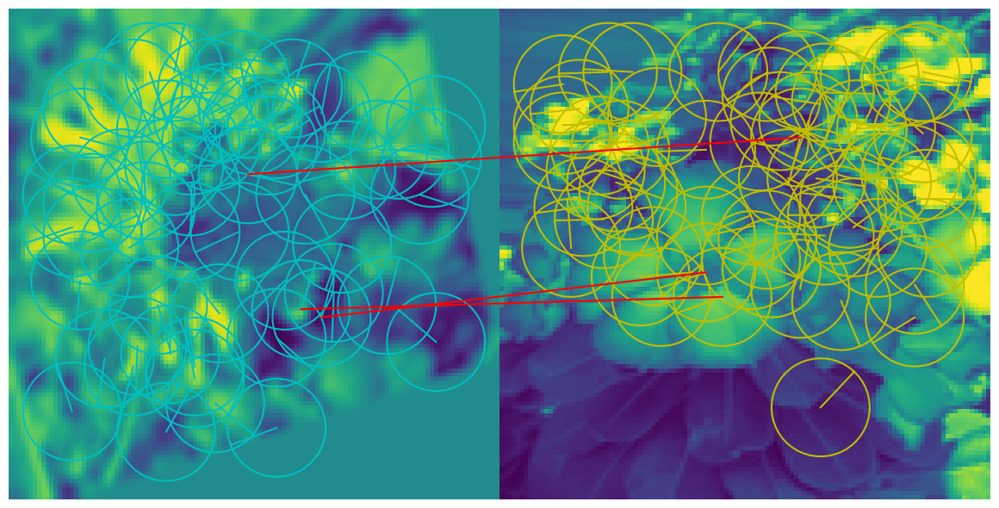

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


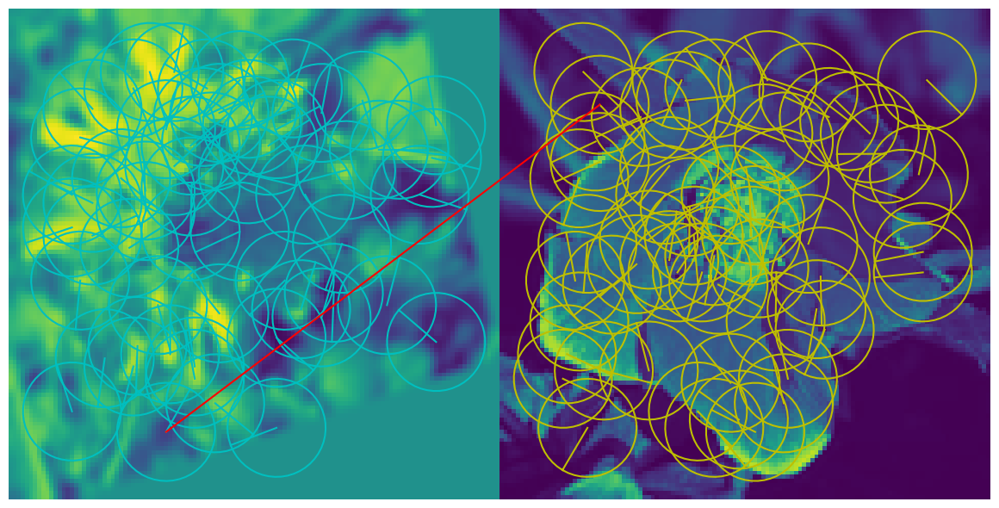

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


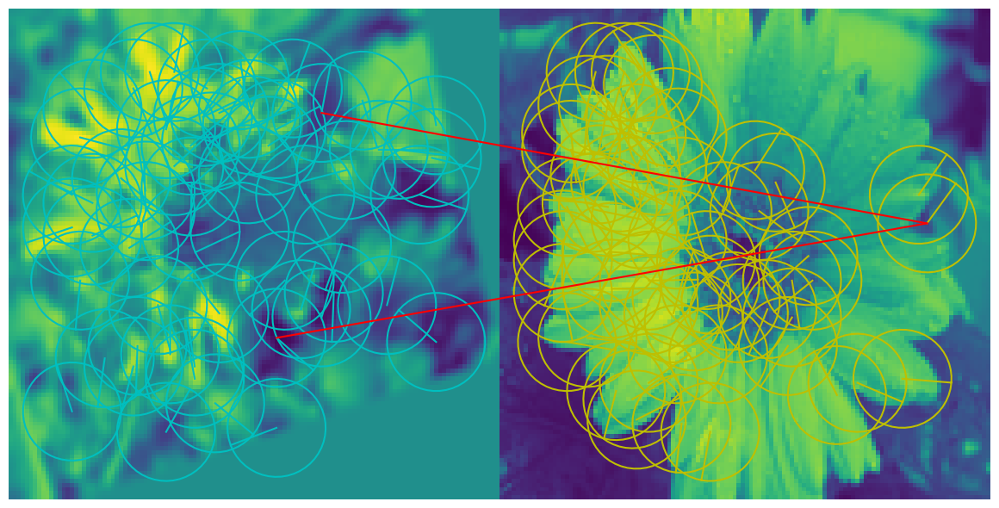

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


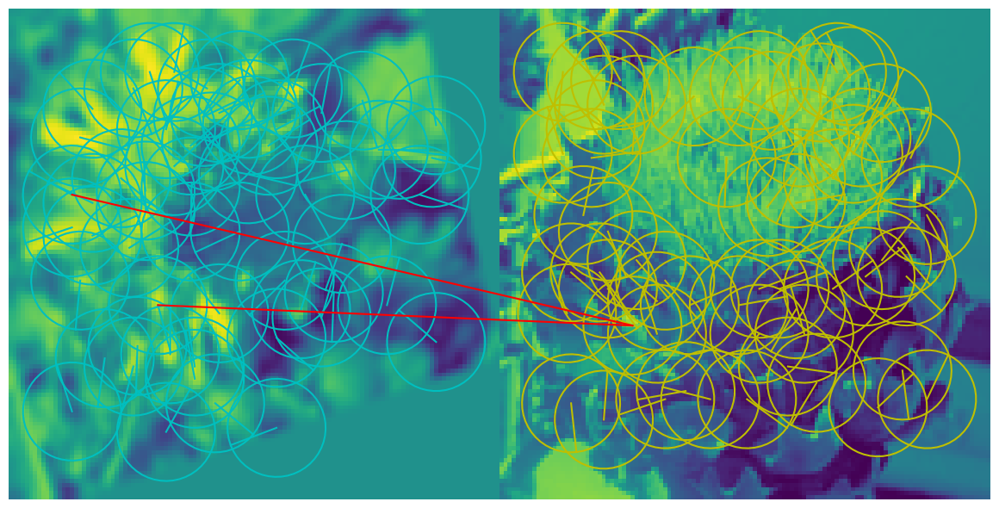

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


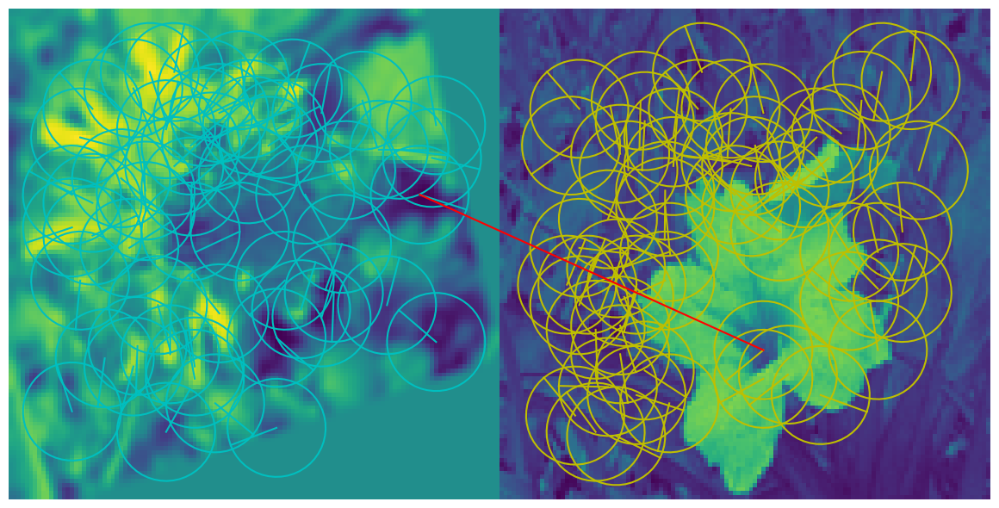

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


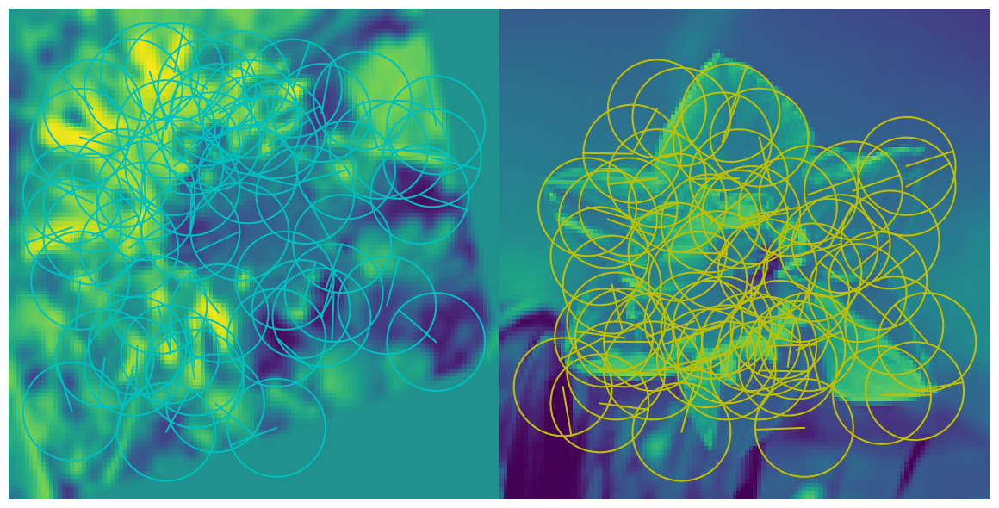

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


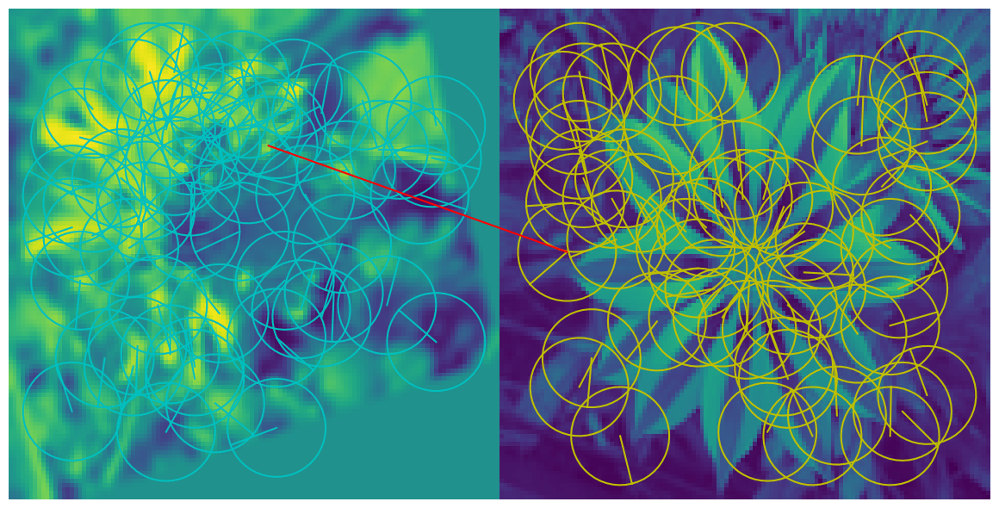

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


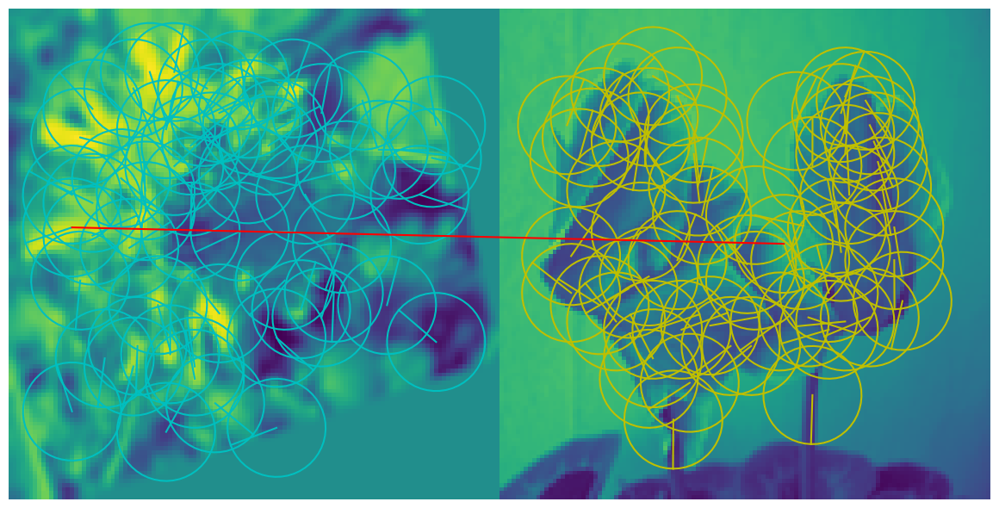

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


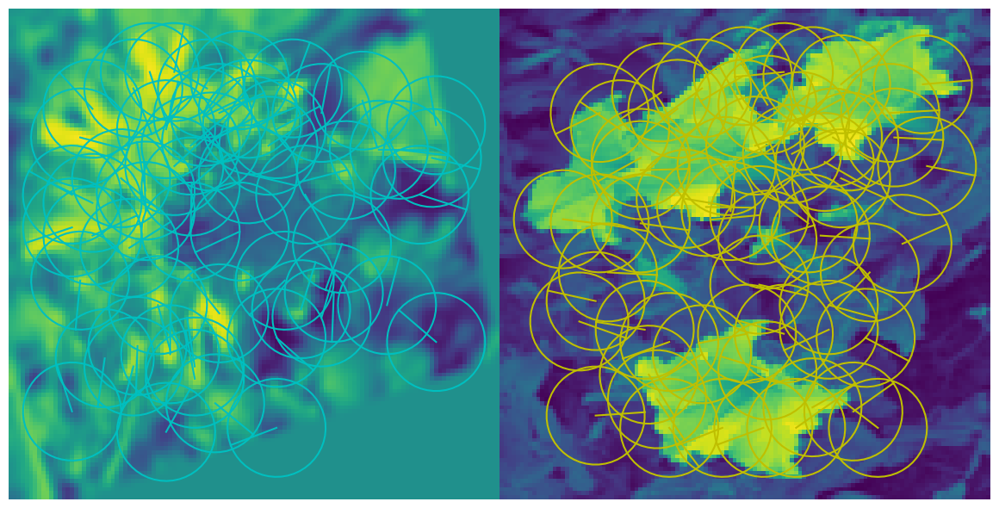

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


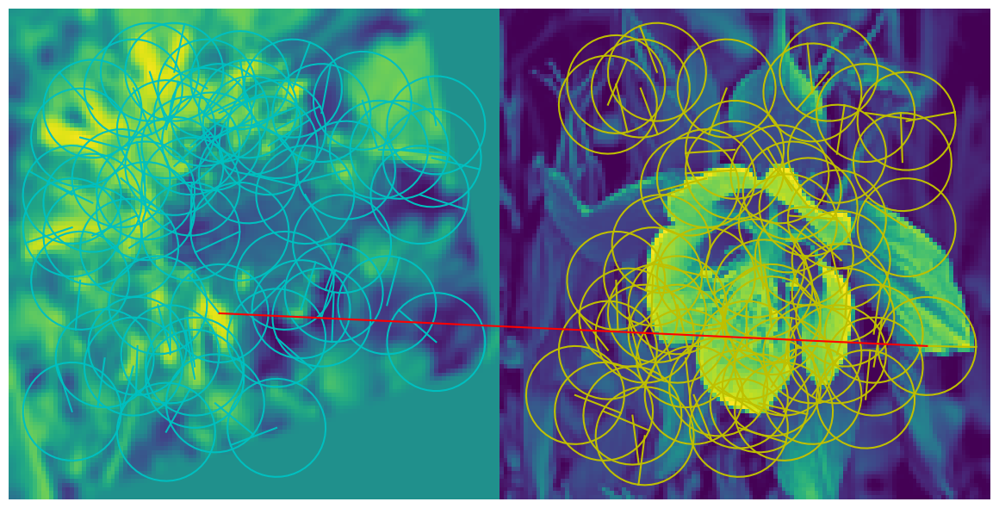

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


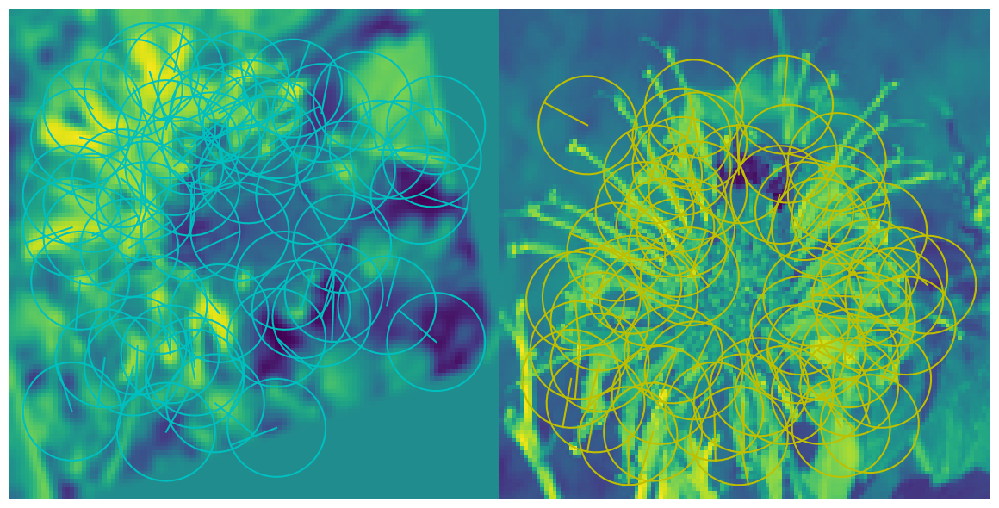

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


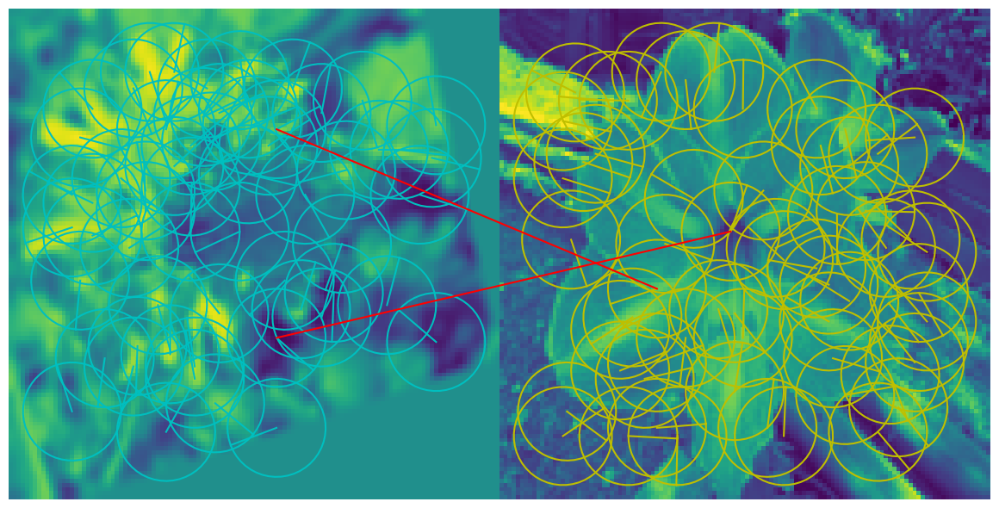

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


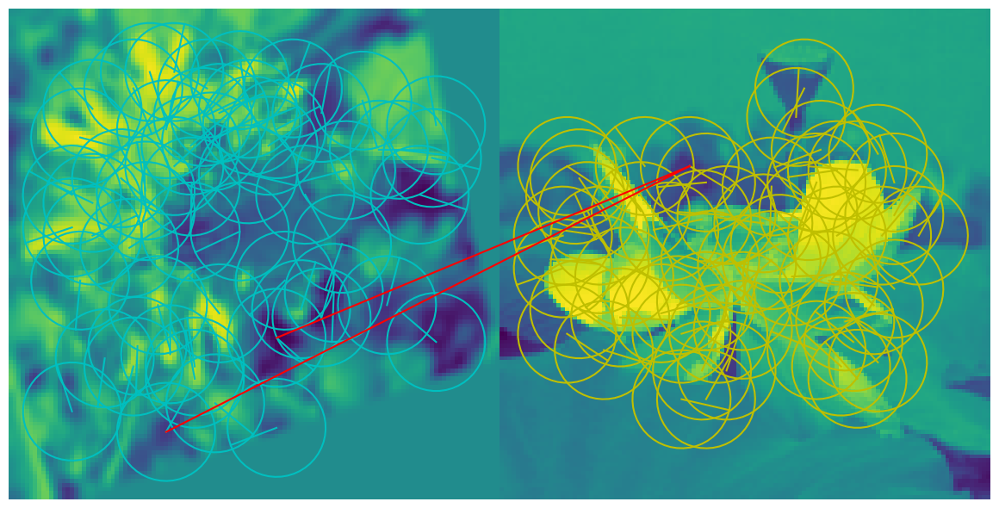

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


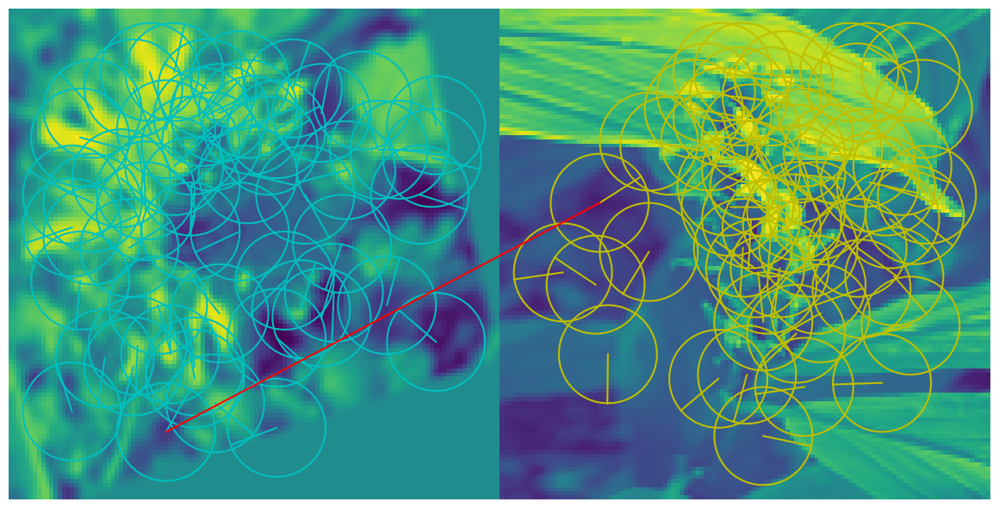

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


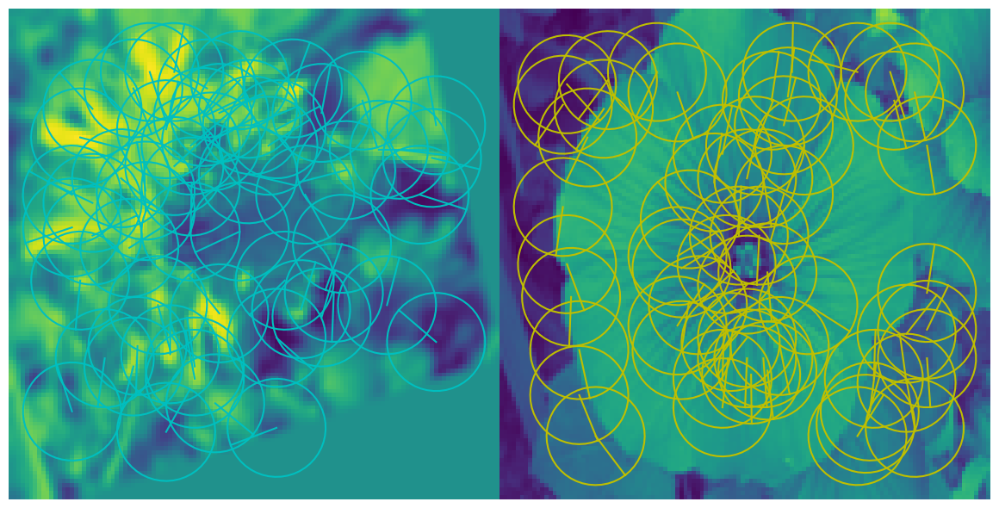

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


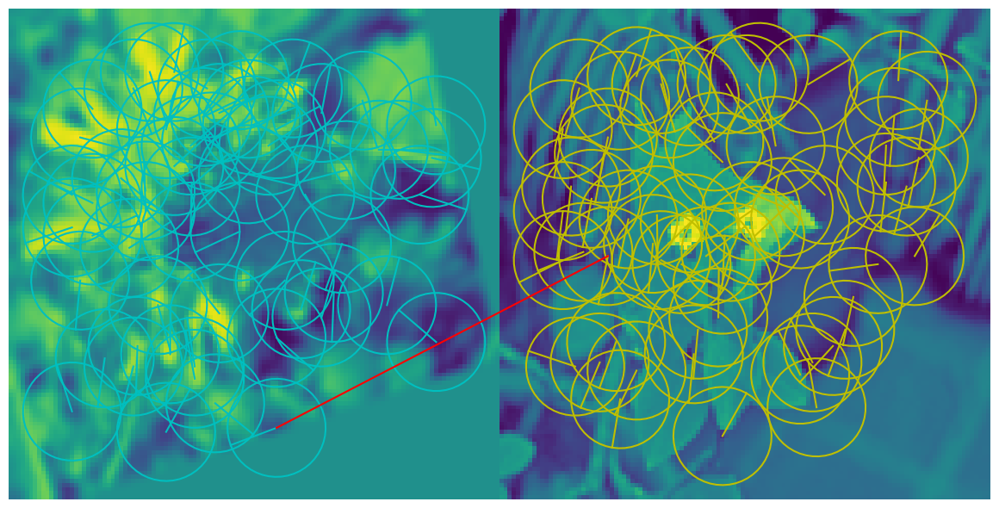

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


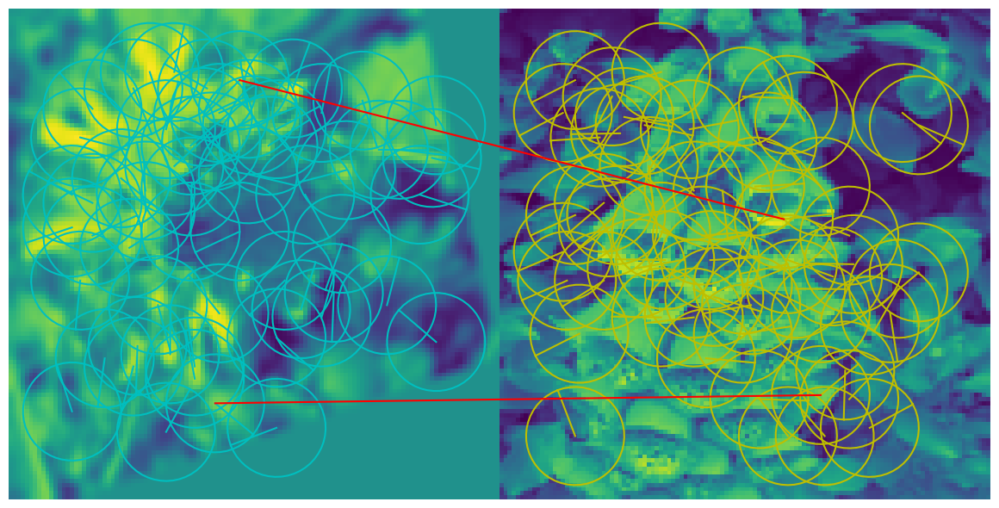

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


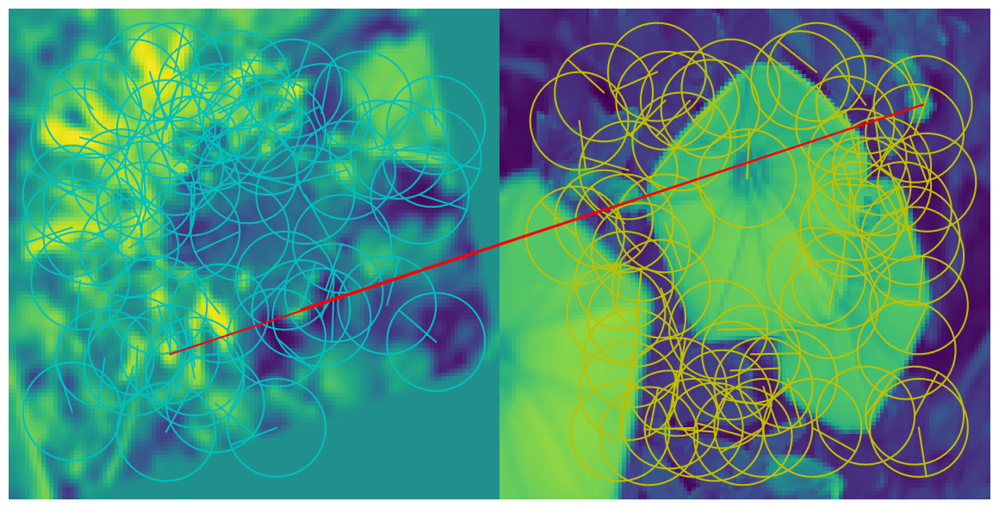

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


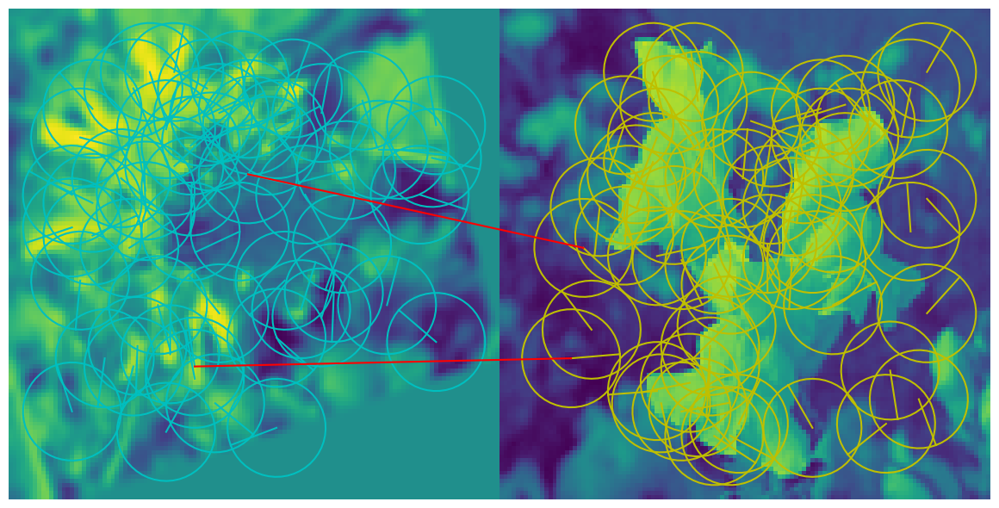

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


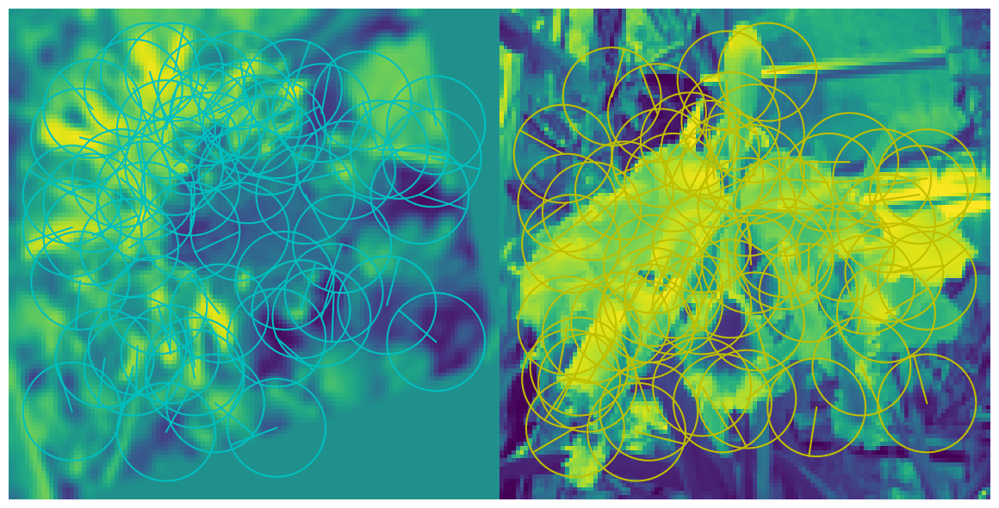

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


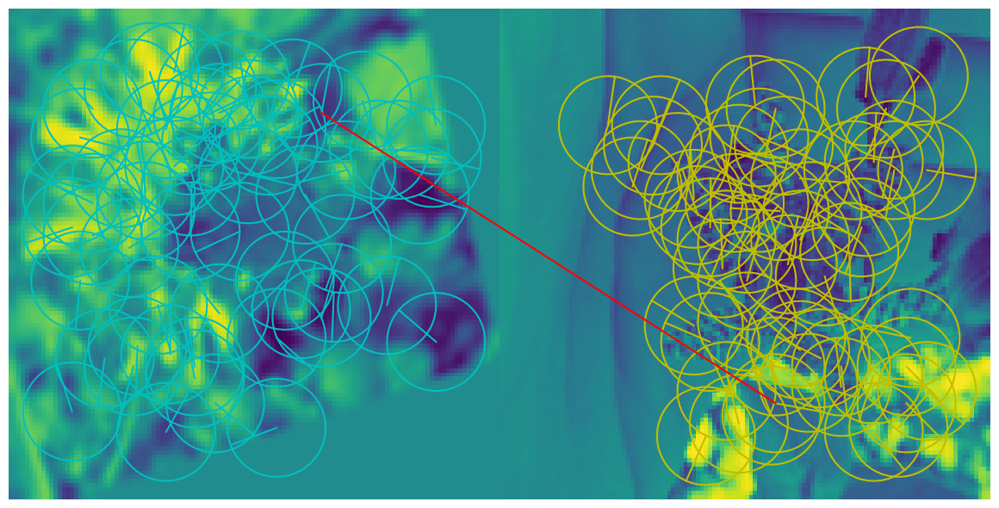

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


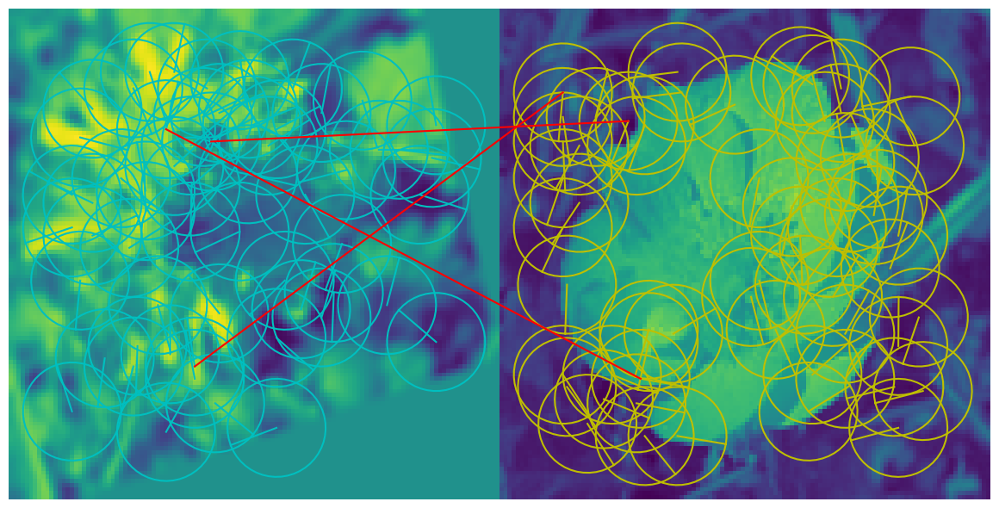

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


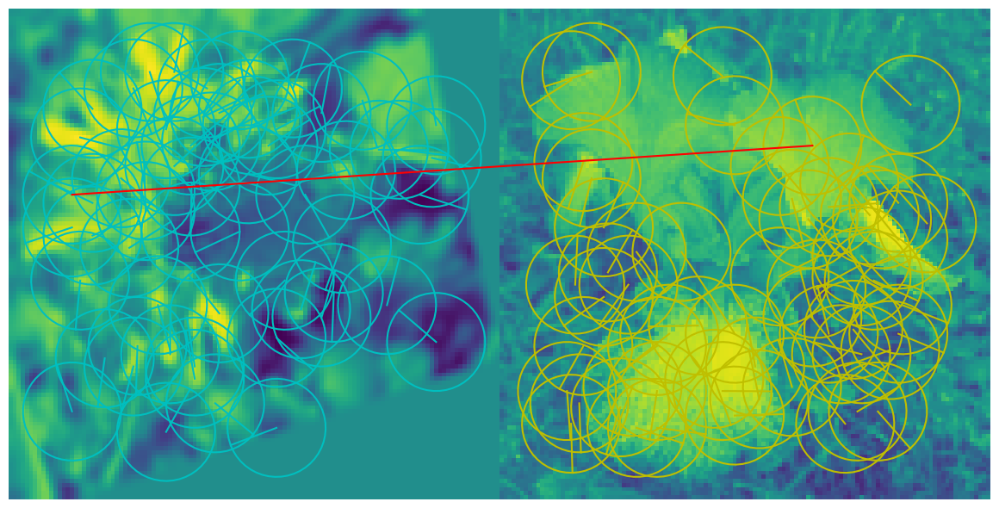

torch.Size([1, 60, 2, 3]) torch.Size([1, 51, 2, 3])
torch.Size([60, 2]) torch.Size([51, 2])


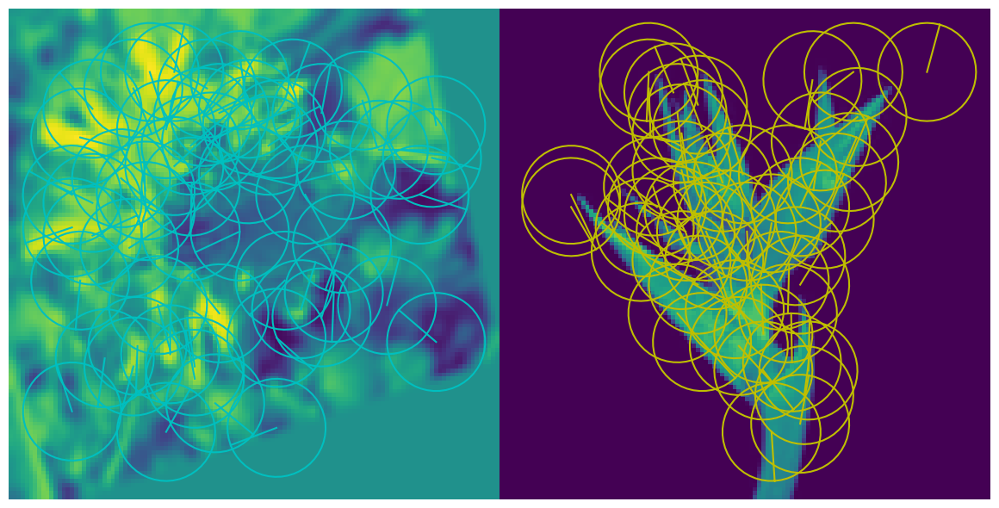

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


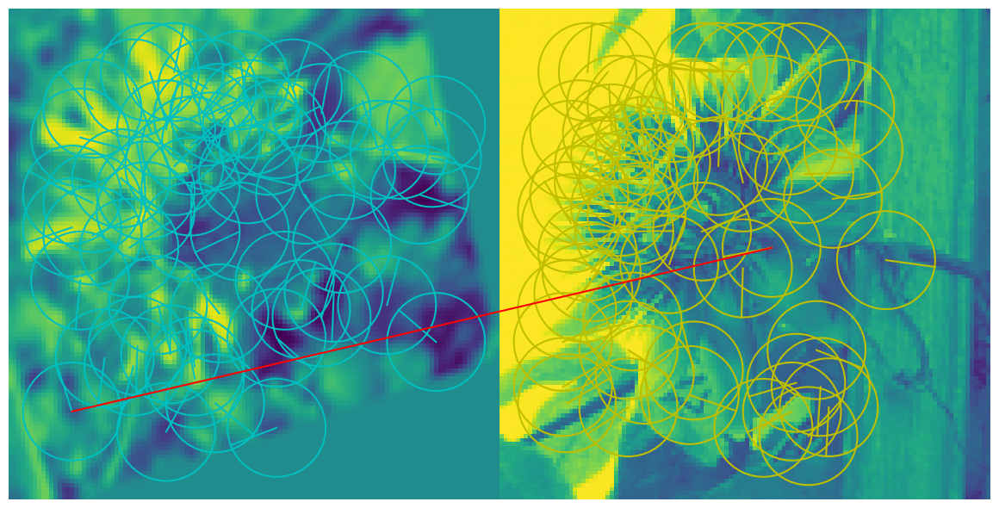

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


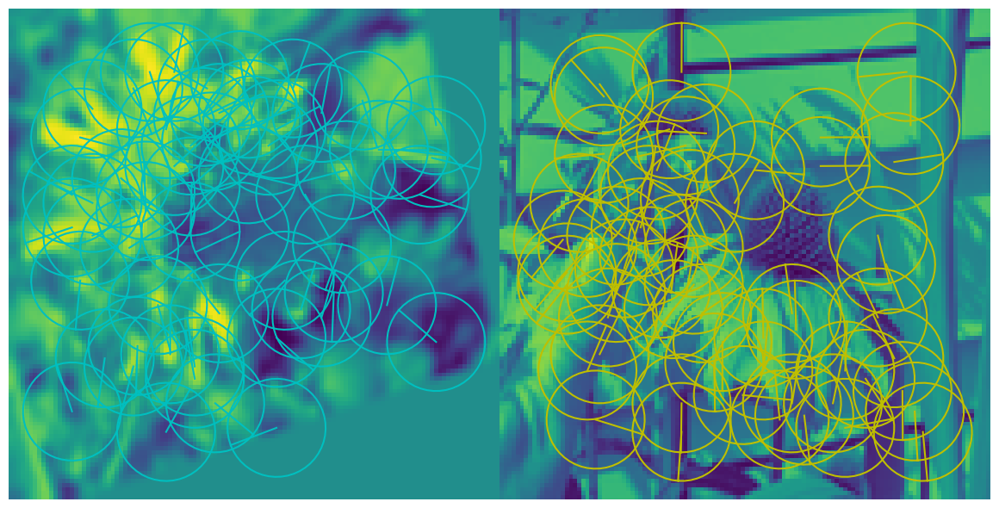

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


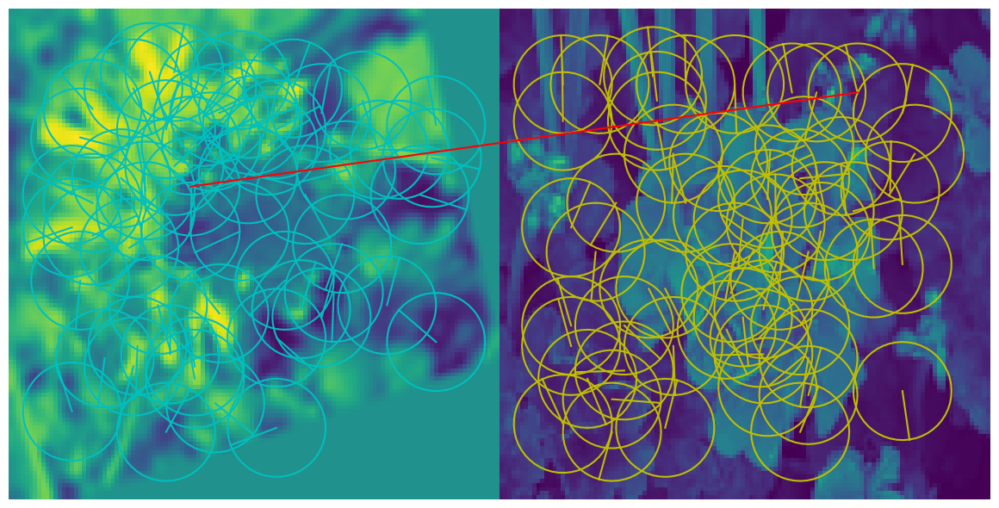

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


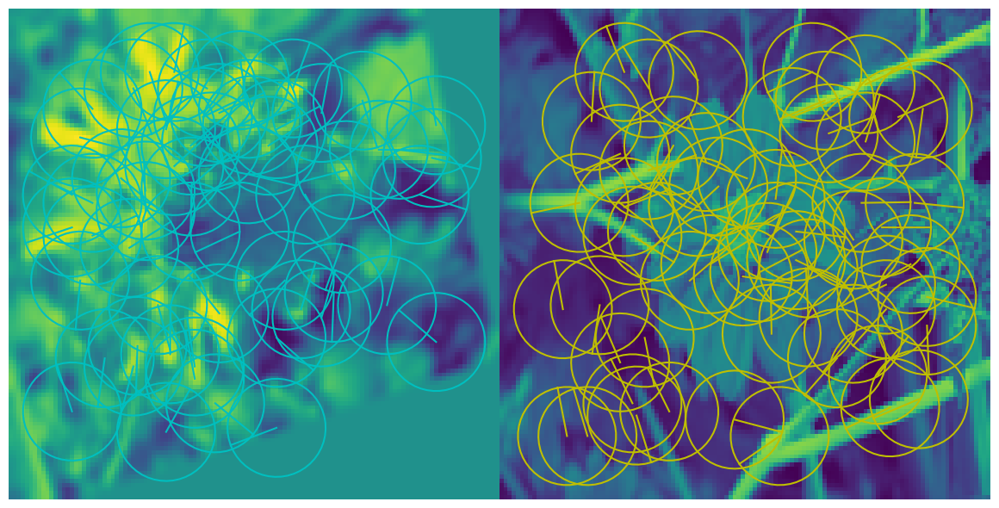

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


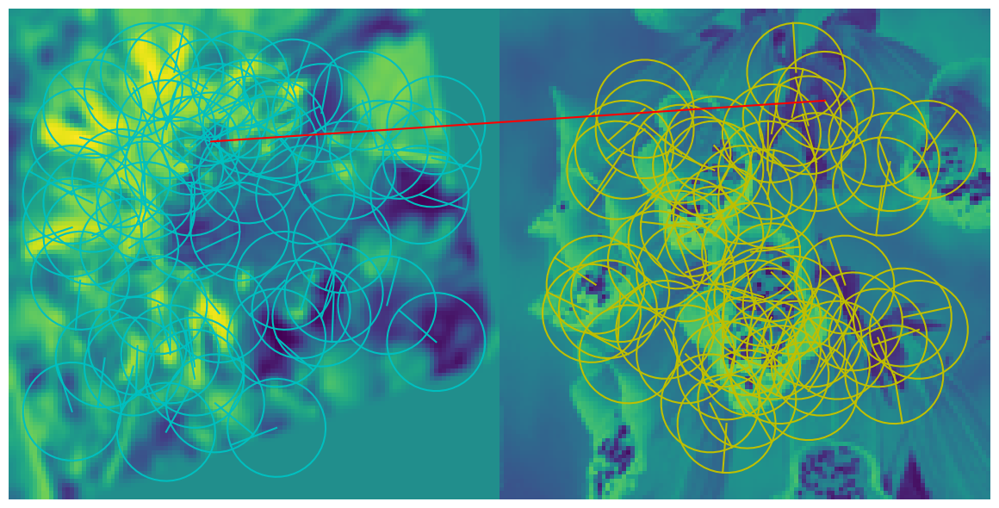

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])


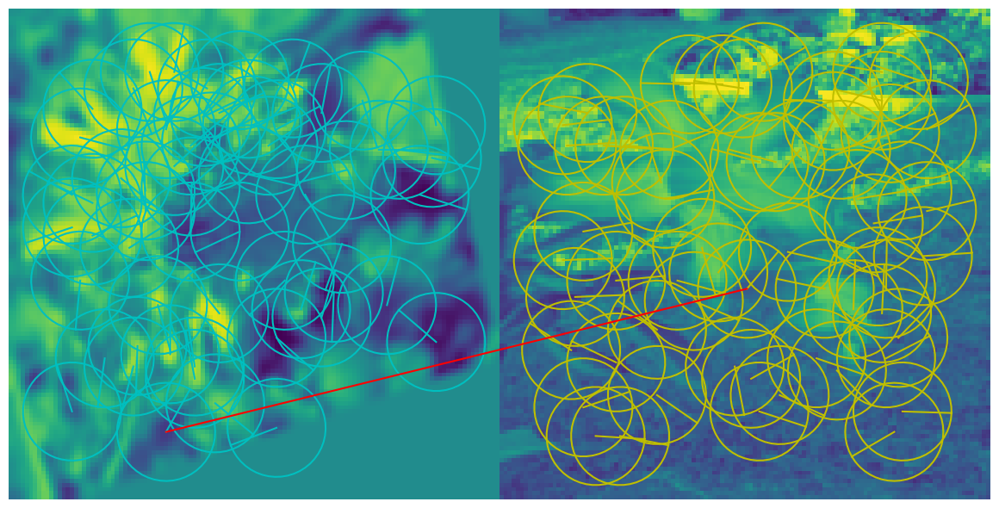

torch.Size([1, 60, 2, 3]) torch.Size([1, 60, 2, 3])
torch.Size([60, 2]) torch.Size([60, 2])
Tempo de execução: 18.71800840100059 segundos


KeyboardInterrupt: 

In [5]:
if __name__ == "__main__":
    set_seed(42)
    # Definição do grid de parâmetros
    param_grid = {
        'num_features': [60],  # Número de características
        'feature_local': [SingularPointSosNet,SingularPointHardNet],  # KeyNetFeatureSIFT,KeyNetFeatureSosNet,REKDSosNet,REKDHardNet,SingularPointSosNet,SingularPointHardNet
        'distance': [0.9],  # Distância para a correspondência (padrão 0.8)
        'threshold': [6]  # Limite para correspondência TODO 5
    }

    # Inicializa o dispositivo (GPU ou CPU)
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    logger.info(f"Dispositivo: {device}")

    trainloader, testloader = read_dataload_flower(120,batch_size=132)# testloader = read_dataload_woods(120,batch_size=132)| read_dataload_flower(120,batch_size=132) | read_dataload_fibers(120,batch_size=132)

    # gerar variacao de transformacoes pespectivas e fotometrica
    iterator = iter(testloader)
    img, labels = next(iterator)
    augmentation_sequence = kornia.augmentation.AugmentationSequential(
        kornia.augmentation.RandomAffine(degrees=360, translate=(0.25, 0.25), scale=(0.95, 1.05), shear=10, p=0.85),
        kornia.augmentation.RandomPerspective(0.3, p=0.85),
        kornia.augmentation.RandomBoxBlur((3, 3), p=0.85),
        data_keys=["input"],
        same_on_batch=True,
    )
    aug_gen = AugmentationGenerator(10,augmentation_sequence=augmentation_sequence)
    aug_gen.generate_variations_image_only(img)

    total_elements = len(testloader.dataset)
    total_batches = len(testloader)
    logger.info(f'Total de elementos no dataset: {total_elements} total batch: {total_batches}')

    all_results = grid_search_pipeline(device, testloader,aug_gen, param_grid)
    print_results_table(all_results)

Set(42|1) limite local 4

FLOWERS
+--------------+----------------------+----------+-----------+----------------------------------+--------+
| Num Features | Feature Local Class  | Distance | Threshold |             Matches              | Scores |
+--------------+----------------------+----------+-----------+----------------------------------+--------+
|      60      |  KeyNetFeatureSIFT   |   0.9    |     4     |  [TP:1360,FN:1676,TN:0,FP:3036]  |  N/A   |
|              |                      |          |           | [P:0.31,R:0.45,F1:0.37,Acc:0.22] |        |
|      60      | KeyNetFeatureSosNet  |   0.9    |     4     | [TP:1449,FN:1587,TN:52,FP:2984]  |  N/A   |
|              |                      |          |           | [P:0.33,R:0.48,F1:0.39,Acc:0.25] |        |
|      60      |      REKDSosNet      |   0.9    |     4     |  [TP:2975,FN:61,TN:104,FP:2932]  |  N/A   |
|              |                      |          |           | [P:0.50,R:0.98,F1:0.67,Acc:0.51] |        |
|      60      |     REKDHardNet      |   0.9    |     4     |   [TP:2939,FN:97,TN:5,FP:3031]   |  N/A   |
|              |                      |          |           | [P:0.49,R:0.97,F1:0.65,Acc:0.48] |        |
|      60      | SingularPointSosNet  |   0.9    |     4     |  [TP:3025,FN:11,TN:61,FP:2975]   |  N/A   |
|              |                      |          |           | [P:0.50,R:1.00,F1:0.67,Acc:0.51] |        |
|      60      | SingularPointHardNet |   0.9    |     4     |   [TP:3013,FN:23,TN:0,FP:3036]   |  N/A   |
|              |                      |          |           | [P:0.50,R:0.99,F1:0.66,Acc:0.50] |        |
+--------------+----------------------+----------+-----------+----------------------------------+--------+

+--------------+----------------------+----------+-----------+----------------------------------+--------+
| Num Features | Feature Local Class  | Distance | Threshold |             Matches              | Scores |
+--------------+----------------------+----------+-----------+----------------------------------+--------+
|      60      |  KeyNetFeatureSIFT   |   0.9    |     5     |  [TP:1360,FN:1676,TN:0,FP:3036]  |  N/A   |
|              |                      |          |           | [P:0.31,R:0.45,F1:0.37,Acc:0.22] |        |
|      60      | KeyNetFeatureSosNet  |   0.9    |     5     | [TP:1439,FN:1597,TN:232,FP:2804] |  N/A   |
|              |                      |          |           | [P:0.34,R:0.47,F1:0.40,Acc:0.28] |        |
|      60      |      REKDSosNet      |   0.9    |     5     |  [TP:2975,FN:61,TN:594,FP:2442]  |  N/A   |
|              |                      |          |           | [P:0.55,R:0.98,F1:0.70,Acc:0.59] |        |
|      60      |     REKDHardNet      |   0.9    |     5     |  [TP:2939,FN:97,TN:105,FP:2931]  |  N/A   |
|              |                      |          |           | [P:0.50,R:0.97,F1:0.66,Acc:0.50] |        |
|      60      | SingularPointSosNet  |   0.9    |     5     |  [TP:3025,FN:11,TN:583,FP:2453]  |  N/A   |
|              |                      |          |           | [P:0.55,R:1.00,F1:0.71,Acc:0.59] |        |
|      60      | SingularPointHardNet |   0.9    |     5     |  [TP:3013,FN:23,TN:67,FP:2969]   |  N/A   |
|              |                      |          |           | [P:0.50,R:0.99,F1:0.67,Acc:0.51] |        |
+--------------+----------------------+----------+-----------+----------------------------------+--------+
+--------------+----------------------+----------+-----------+----------------------------------+--------+
| Num Features | Feature Local Class  | Distance | Threshold |             Matches              | Scores |
+--------------+----------------------+----------+-----------+----------------------------------+--------+
|      60      |  KeyNetFeatureSIFT   |   0.9    |     6     |  [TP:1360,FN:1676,TN:0,FP:3036]  |  N/A   |
|              |                      |          |           | [P:0.31,R:0.45,F1:0.37,Acc:0.22] |        |
|      60      | KeyNetFeatureSosNet  |   0.9    |     6     | [TP:1413,FN:1623,TN:594,FP:2442] |  N/A   |
|              |                      |          |           | [P:0.37,R:0.47,F1:0.41,Acc:0.33] |        |
|      60      |      REKDSosNet      |   0.9    |     6     | [TP:2974,FN:62,TN:1458,FP:1578]  |  N/A   |
|              |                      |          |           | [P:0.65,R:0.98,F1:0.78,Acc:0.73] |        |
|      60      |     REKDHardNet      |   0.9    |     6     |  [TP:2939,FN:97,TN:490,FP:2546]  |  N/A   |
|              |                      |          |           | [P:0.54,R:0.97,F1:0.69,Acc:0.56] |        |
|      60      | SingularPointSosNet  |   0.9    |     6     | [TP:3025,FN:11,TN:1399,FP:1637]  |  N/A   |
|              |                      |          |           | [P:0.65,R:1.00,F1:0.79,Acc:0.73] |        |
|      60      | SingularPointHardNet |   0.9    |     6     |  [TP:3013,FN:23,TN:410,FP:2626]  |  N/A   |
|              |                      |          |           | [P:0.53,R:0.99,F1:0.69,Acc:0.56] |        |
+--------------+----------------------+----------+-----------+----------------------------------+--------+
Método & Conj. & TP & FN & TN & FP & Prec. & Rec. & F1 & Acc. & Spec. & FPR & FNR & \begin{tabular}{@{}c@{}}Bal. \\ Acc.\end{tabular} \\
+--------------+----------------------+----------+-----------+-----------------------------------+--------+
| Num Features | Feature Local Class  | Distance | Threshold |              Matches              | Scores |
+--------------+----------------------+----------+-----------+-----------------------------------+--------+
|      60      |  KeyNetFeatureSIFT   |   0.9    |     8     |  [TP:1359,FN:1677,TN:84,FP:2952]  |  N/A   |
|              |                      |          |           |  [P:0.32,R:0.45,F1:0.37,Acc:0.24] |        |
|      60      | KeyNetFeatureSosNet  |   0.9    |     8     | [TP:1308,FN:1728,TN:1676,FP:1360] |  N/A   |
|              |                      |          |           |  [P:0.49,R:0.43,F1:0.46,Acc:0.49] |        |
|      60      |      REKDSosNet      |   0.9    |     8     |   [TP:2955,FN:81,TN:2395,FP:641]  |  N/A   |
|              |                      |          |           |  [P:0.82,R:0.97,F1:0.89,Acc:0.88] |        |
|      60      |     REKDHardNet      |   0.9    |     8     |  [TP:2932,FN:104,TN:1682,FP:1354] |  N/A   |
|              |                      |          |           |  [P:0.68,R:0.97,F1:0.80,Acc:0.76] |        |
|      60      | SingularPointSosNet  |   0.9    |     8     |   [TP:3022,FN:14,TN:2570,FP:466]  |  N/A   |
|              |                      |          |           |  [P:0.87,R:1.00,F1:0.93,Acc:0.92] |        |
|      60      | SingularPointHardNet |   0.9    |     8     |  [TP:3011,FN:25,TN:1665,FP:1371]  |  N/A   |
|              |                      |          |           |  [P:0.69,R:0.99,F1:0.81,Acc:0.77] |        |
+--------------+----------------------+----------+-----------+-----------------------------------+--------+
WOODS
+--------------+----------------------+----------+-----------+-----------------------------------+--------+
| Num Features | Feature Local Class  | Distance | Threshold |              Matches              | Scores |
+--------------+----------------------+----------+-----------+-----------------------------------+--------+
|      60      |  KeyNetFeatureSIFT   |   0.9    |     4     |  [TP:1364,FN:2596,TN:44,FP:3916]  |  N/A   |
|              |                      |          |           |  [P:0.26,R:0.34,F1:0.30,Acc:0.18] |        |
|      60      | KeyNetFeatureSosNet  |   0.9    |     4     | [TP:1848,FN:2112,TN:1096,FP:2864] |  N/A   |
|              |                      |          |           |  [P:0.39,R:0.47,F1:0.43,Acc:0.37] |        |
|      60      |      REKDSosNet      |   0.9    |     4     |  [TP:2874,FN:1086,TN:3351,FP:609] |  N/A   |
|              |                      |          |           |  [P:0.83,R:0.73,F1:0.77,Acc:0.79] |        |
|      60      |     REKDHardNet      |   0.9    |     4     | [TP:2923,FN:1037,TN:2924,FP:1036] |  N/A   |
|              |                      |          |           |  [P:0.74,R:0.74,F1:0.74,Acc:0.74] |        |
|      60      | SingularPointSosNet  |   0.9    |     4     |  [TP:3831,FN:129,TN:3026,FP:934]  |  N/A   |
|              |                      |          |           |  [P:0.80,R:0.97,F1:0.88,Acc:0.87] |        |
|      60      | SingularPointHardNet |   0.9    |     4     |  [TP:3836,FN:124,TN:1929,FP:2031] |  N/A   |
|              |                      |          |           |  [P:0.65,R:0.97,F1:0.78,Acc:0.73] |        |
+--------------+----------------------+----------+-----------+-----------------------------------+--------+
+--------------+----------------------+----------+-----------+-----------------------------------+--------+
| Num Features | Feature Local Class  | Distance | Threshold |              Matches              | Scores |
+--------------+----------------------+----------+-----------+-----------------------------------+--------+
|      60      |  KeyNetFeatureSIFT   |   0.9    |     6     |  [TP:1351,FN:2609,TN:357,FP:3603] |  N/A   |
|              |                      |          |           |  [P:0.27,R:0.34,F1:0.30,Acc:0.22] |        |
|      60      | KeyNetFeatureSosNet  |   0.9    |     6     | [TP:1620,FN:2340,TN:2913,FP:1047] |  N/A   |
|              |                      |          |           |  [P:0.61,R:0.41,F1:0.49,Acc:0.57] |        |
|      60      |      REKDSosNet      |   0.9    |     6     |  [TP:2449,FN:1511,TN:3830,FP:130] |  N/A   |
|              |                      |          |           |  [P:0.95,R:0.62,F1:0.75,Acc:0.79] |        |
|      60      |     REKDHardNet      |   0.9    |     6     |  [TP:2503,FN:1457,TN:3775,FP:185] |  N/A   |
|              |                      |          |           |  [P:0.93,R:0.63,F1:0.75,Acc:0.79] |        |
|      60      | SingularPointSosNet  |   0.9    |     6     |  [TP:3697,FN:263,TN:3846,FP:114]  |  N/A   |
|              |                      |          |           |  [P:0.97,R:0.93,F1:0.95,Acc:0.95] |        |
|      60      | SingularPointHardNet |   0.9    |     6     |  [TP:3739,FN:221,TN:3547,FP:413]  |  N/A   |
|              |                      |          |           |  [P:0.90,R:0.94,F1:0.92,Acc:0.92] |        |
+--------------+----------------------+----------+-----------+-----------------------------------+--------+
+--------------+----------------------+----------+-----------+----------------------------------+--------+
| Num Features | Feature Local Class  | Distance | Threshold |             Matches              | Scores |
+--------------+----------------------+----------+-----------+----------------------------------+--------+
|      60      |  KeyNetFeatureSIFT   |   0.9    |     6     |  [TP:1360,FN:1676,TN:0,FP:3036]  |  N/A   |
|              |                      |          |           | [P:0.31,R:0.45,F1:0.37,Acc:0.22] |        |
|      60      | KeyNetFeatureSosNet  |   0.9    |     6     | [TP:1413,FN:1623,TN:594,FP:2442] |  N/A   |
|              |                      |          |           | [P:0.37,R:0.47,F1:0.41,Acc:0.33] |        |
|      60      |      REKDSosNet      |   0.9    |     6     | [TP:2974,FN:62,TN:1458,FP:1578]  |  N/A   |
|              |                      |          |           | [P:0.65,R:0.98,F1:0.78,Acc:0.73] |        |
|      60      |     REKDHardNet      |   0.9    |     6     |  [TP:2939,FN:97,TN:490,FP:2546]  |  N/A   |
|              |                      |          |           | [P:0.54,R:0.97,F1:0.69,Acc:0.56] |        |
|      60      | SingularPointSosNet  |   0.9    |     6     | [TP:3025,FN:11,TN:1399,FP:1637]  |  N/A   |
|              |                      |          |           | [P:0.65,R:1.00,F1:0.79,Acc:0.73] |        |
|      60      | SingularPointHardNet |   0.9    |     6     |  [TP:3013,FN:23,TN:410,FP:2626]  |  N/A   |
|              |                      |          |           | [P:0.53,R:0.99,F1:0.69,Acc:0.56] |        |
+--------------+----------------------+----------+-----------+----------------------------------+--------+
+--------------+----------------------+----------+-----------+-----------------------------------+--------+
| Num Features | Feature Local Class  | Distance | Threshold |              Matches              | Scores |
+--------------+----------------------+----------+-----------+-----------------------------------+--------+
|      60      |  KeyNetFeatureSIFT   |   0.9    |     8     | [TP:1254,FN:2706,TN:1169,FP:2791] |  N/A   |
|              |                      |          |           |  [P:0.31,R:0.32,F1:0.31,Acc:0.31] |        |
|      60      | KeyNetFeatureSosNet  |   0.9    |     8     |  [TP:1263,FN:2697,TN:3679,FP:281] |  N/A   |
|              |                      |          |           |  [P:0.82,R:0.32,F1:0.46,Acc:0.62] |        |
|      60      |      REKDSosNet      |   0.9    |     8     |  [TP:2090,FN:1870,TN:3922,FP:38]  |  N/A   |
|              |                      |          |           |  [P:0.98,R:0.53,F1:0.69,Acc:0.76] |        |
|      60      |     REKDHardNet      |   0.9    |     8     |  [TP:2172,FN:1788,TN:3913,FP:47]  |  N/A   |
|              |                      |          |           |  [P:0.98,R:0.55,F1:0.70,Acc:0.77] |        |
|      60      | SingularPointSosNet  |   0.9    |     8     |   [TP:3445,FN:515,TN:3929,FP:31]  |  N/A   |
|              |                      |          |           |  [P:0.99,R:0.87,F1:0.93,Acc:0.93] |        |
|      60      | SingularPointHardNet |   0.9    |     8     |  [TP:3530,FN:430,TN:3790,FP:170]  |  N/A   |
|              |                      |          |           |  [P:0.95,R:0.89,F1:0.92,Acc:0.92] |        |
+--------------+----------------------+----------+-----------+-----------------------------------+--------+



FIBERS
+--------------+----------------------+----------+-----------+----------------------------------+--------+
| Num Features | Feature Local Class  | Distance | Threshold |             Matches              | Scores |
+--------------+----------------------+----------+-----------+----------------------------------+--------+
|      60      |  KeyNetFeatureSIFT   |   0.9    |     4     |   [TP:34,FN:164,TN:24,FP:174]    |  N/A   |
|              |                      |          |           | [P:0.16,R:0.17,F1:0.17,Acc:0.15] |        |
|      60      | KeyNetFeatureSosNet  |   0.9    |     4     |    [TP:1,FN:197,TN:71,FP:127]    |  N/A   |
|              |                      |          |           | [P:0.01,R:0.01,F1:0.01,Acc:0.18] |        |
|      60      |      REKDSosNet      |   0.9    |     4     |    [TP:2,FN:196,TN:59,FP:139]    |  N/A   |
|              |                      |          |           | [P:0.01,R:0.01,F1:0.01,Acc:0.15] |        |
|      60      |     REKDHardNet      |   0.9    |     4     |    [TP:5,FN:193,TN:64,FP:134]    |  N/A   |
|              |                      |          |           | [P:0.04,R:0.03,F1:0.03,Acc:0.17] |        |
|      60      | SingularPointSosNet  |   0.9    |     4     |   [TP:135,FN:63,TN:177,FP:21]    |  N/A   |
|              |                      |          |           | [P:0.87,R:0.68,F1:0.76,Acc:0.79] |        |
|      60      | SingularPointHardNet |   0.9    |     4     |   [TP:143,FN:55,TN:148,FP:50]    |  N/A   |
|              |                      |          |           | [P:0.74,R:0.72,F1:0.73,Acc:0.73] |        |
+--------------+----------------------+----------+-----------+----------------------------------+--------+
+--------------+----------------------+----------+-----------+----------------------------------+--------+
| Num Features | Feature Local Class  | Distance | Threshold |             Matches              | Scores |
+--------------+----------------------+----------+-----------+----------------------------------+--------+
|      60      |  KeyNetFeatureSIFT   |   0.9    |     6     |   [TP:34,FN:164,TN:60,FP:138]    |  N/A   |
|              |                      |          |           | [P:0.20,R:0.17,F1:0.18,Acc:0.24] |        |
|      60      | KeyNetFeatureSosNet  |   0.9    |     6     |    [TP:1,FN:197,TN:138,FP:60]    |  N/A   |
|              |                      |          |           | [P:0.02,R:0.01,F1:0.01,Acc:0.35] |        |
|      60      |      REKDSosNet      |   0.9    |     6     |    [TP:1,FN:197,TN:135,FP:63]    |  N/A   |
|              |                      |          |           | [P:0.02,R:0.01,F1:0.01,Acc:0.34] |        |
|      60      |     REKDHardNet      |   0.9    |     6     |    [TP:3,FN:195,TN:72,FP:126]    |  N/A   |
|              |                      |          |           | [P:0.02,R:0.02,F1:0.02,Acc:0.19] |        |
|      60      | SingularPointSosNet  |   0.9    |     6     |    [TP:114,FN:84,TN:198,FP:0]    |  N/A   |
|              |                      |          |           | [P:1.00,R:0.58,F1:0.73,Acc:0.79] |        |
|      60      | SingularPointHardNet |   0.9    |     6     |    [TP:122,FN:76,TN:195,FP:3]    |  N/A   |
|              |                      |          |           | [P:0.98,R:0.62,F1:0.76,Acc:0.80] |        |
+--------------+----------------------+----------+-----------+----------------------------------+--------+
+--------------+----------------------+----------+-----------+----------------------------------+--------+
| Num Features | Feature Local Class  | Distance | Threshold |             Matches              | Scores |
+--------------+----------------------+----------+-----------+----------------------------------+--------+
|      60      |  KeyNetFeatureSIFT   |   0.9    |     8     |   [TP:24,FN:174,TN:106,FP:92]    |  N/A   |
|              |                      |          |           | [P:0.21,R:0.12,F1:0.15,Acc:0.33] |        |
|      60      | KeyNetFeatureSosNet  |   0.9    |     8     |    [TP:0,FN:198,TN:176,FP:22]    |  N/A   |
|              |                      |          |           | [P:0.00,R:0.00,F1:0.00,Acc:0.44] |        |
|      60      |      REKDSosNet      |   0.9    |     8     |    [TP:0,FN:198,TN:188,FP:10]    |  N/A   |
|              |                      |          |           | [P:0.00,R:0.00,F1:0.00,Acc:0.47] |        |
|      60      |     REKDHardNet      |   0.9    |     8     |    [TP:1,FN:197,TN:94,FP:104]    |  N/A   |
|              |                      |          |           | [P:0.01,R:0.01,F1:0.01,Acc:0.24] |        |
|      60      | SingularPointSosNet  |   0.9    |     8     |    [TP:89,FN:109,TN:198,FP:0]    |  N/A   |
|              |                      |          |           | [P:1.00,R:0.45,F1:0.62,Acc:0.72] |        |
|      60      | SingularPointHardNet |   0.9    |     8     |    [TP:104,FN:94,TN:197,FP:1]    |  N/A   |
|              |                      |          |           | [P:0.99,R:0.53,F1:0.69,Acc:0.76] |        |
+--------------+----------------------+----------+-----------+----------------------------------+--------+




Set(42|1) limite local 5

FLOWERS
+--------------+----------------------+----------+-----------+----------------------------------+--------+
| Num Features | Feature Local Class  | Distance | Threshold |             Matches              | Scores |
+--------------+----------------------+----------+-----------+----------------------------------+--------+
|      60      |  KeyNetFeatureSIFT   |   0.9    |     4     |  [TP:1360,FN:1676,TN:0,FP:3036]  |  N/A   |
|              |                      |          |           | [P:0.31,R:0.45,F1:0.37,Acc:0.22] |        |
|      60      | KeyNetFeatureSosNet  |   0.9    |     4     | [TP:1449,FN:1587,TN:52,FP:2984]  |  N/A   |
|              |                      |          |           | [P:0.33,R:0.48,F1:0.39,Acc:0.25] |        |
|      60      |      REKDSosNet      |   0.9    |     4     |  [TP:2975,FN:61,TN:104,FP:2932]  |  N/A   |
|              |                      |          |           | [P:0.50,R:0.98,F1:0.67,Acc:0.51] |        |
|      60      |     REKDHardNet      |   0.9    |     4     |   [TP:2939,FN:97,TN:5,FP:3031]   |  N/A   |
|              |                      |          |           | [P:0.49,R:0.97,F1:0.65,Acc:0.48] |        |
|      60      | SingularPointSosNet  |   0.9    |     4     |  [TP:3025,FN:11,TN:61,FP:2975]   |  N/A   |
|              |                      |          |           | [P:0.50,R:1.00,F1:0.67,Acc:0.51] |        |
|      60      | SingularPointHardNet |   0.9    |     4     |   [TP:3013,FN:23,TN:0,FP:3036]   |  N/A   |
|              |                      |          |           | [P:0.50,R:0.99,F1:0.66,Acc:0.50] |        |
+--------------+----------------------+----------+-----------+----------------------------------+--------+

aug_gen = kornia.augmentation.AugmentationSequential(
    kornia.augmentation.RandomAffine(degrees=360, translate=(0.25, 0.25), scale=(0.95, 1.05), shear=10, p=0.85),
    kornia.augmentation.RandomPerspective(0.3, p=0.85),
    kornia.augmentation.RandomBoxBlur((3, 3), p=0.85),
    data_keys=["input"],
    same_on_batch=True,
)


FLOWERS
1020

INFO:Main:Executando experimento com: 60 características, detector KeyNetFeatureSIFT, distância 0.9, e limiar 5
INFO:Main:TP: 259, FP: 510, FN: 251
INFO:Main:Precisão: 0.34, Recall: 0.51, F1-score: 0.41
INFO:Main:Executando experimento com: 60 características, detector KeyNetFeatureSosNet, distância 0.9, e limiar 5
INFO:Main:TP: 293, FP: 122, FN: 217
INFO:Main:Precisão: 0.71, Recall: 0.57, F1-score: 0.63
INFO:Main:Executando experimento com: 60 características, detector REKDSosNet, distância 0.9, e limiar 5
INFO:Main:TP: 506, FP: 171, FN: 4
INFO:Main:Precisão: 0.75, Recall: 0.99, F1-score: 0.85
INFO:Main:Executando experimento com: 60 características, detector SingularPointSosNet, distância 0.9, e limiar 5
INFO:Main:TP: 510, FP: 165, FN: 0
INFO:Main:Precisão: 0.76, Recall: 1.00, F1-score: 0.86

6072
INFO:Main:Executando experimento com: 60 características, detector KeyNetFeatureSIFT, distância 0.9, e limiar 5
INFO:Main:TP: 1358, FP: 3036, FN: 1678
INFO:Main:Precisão: 0.31, Recall: 0.45, F1-score: 0.37
INFO:Main:Executando experimento com: 60 características, detector KeyNetFeatureSosNet, distância 0.9, e limiar 5
INFO:Main:TP: 1560, FP: 1243, FN: 1476
INFO:Main:Precisão: 0.56, Recall: 0.51, F1-score: 0.53
INFO:Main:Executando experimento com: 60 características, detector REKDSosNet, distância 0.9, e limiar 5
INFO:Main:TP: 3027, FP: 1619, FN: 9
INFO:Main:Precisão: 0.65, Recall: 1.00, F1-score: 0.79
INFO:Main:Executando experimento com: 60 características, detector REKDHardNet, distância 0.9, e limiar 5
INFO:Main:TP: 3017, FP: 2493, FN: 19
INFO:Main:Precisão: 0.55, Recall: 0.99, F1-score: 0.71
INFO:Main:Executando experimento com: 60 características, detector SingularPointSosNet, distância 0.9, e limiar 5
INFO:Main:TP: 3035, FP: 1645, FN: 1
INFO:Main:Precisão: 0.65, Recall: 1.00, F1-score: 0.79
INFO:Main:Executando experimento com: 60 características, detector SingularPointHardNet, distância 0.9, e limiar 5
INFO:Main:TP: 3033, FP: 2459, FN: 3
INFO:Main:Precisão: 0.55, Recall: 1.00, F1-score: 0.71




WOODS

INFO:Main:Executando experimento com: 60 características, detector KeyNetFeatureSIFT, distância 0.9, e limiar 5
INFO:Main:TP: 567, FP: 3947, FN: 3393
INFO:Main:Precisão: 0.13, Recall: 0.14, F1-score: 0.13
INFO:Main:Executando experimento com: 60 características, detector KeyNetFeatureSosNet, distância 0.9, e limiar 5
INFO:Main:TP: 2141, FP: 1976, FN: 1819
INFO:Main:Precisão: 0.52, Recall: 0.54, F1-score: 0.53
INFO:Main:Executando experimento com: 60 características, detector REKDSosNet, distância 0.9, e limiar 5
INFO:Main:TP: 2670, FP: 2858, FN: 1290
INFO:Main:Precisão: 0.48, Recall: 0.67, F1-score: 0.56
INFO:Main:Executando experimento com: 60 características, detector REKDHardNet, distância 0.9, e limiar 5
INFO:Main:TP: 2604, FP: 3185, FN: 1356
INFO:Main:Precisão: 0.45, Recall: 0.66, F1-score: 0.53
INFO:Main:Executando experimento com: 60 características, detector SingularPointSosNet, distância 0.9, e limiar 5
INFO:Main:TP: 3862, FP: 1141, FN: 98
INFO:Main:Precisão: 0.77, Recall: 0.98, F1-score: 0.86
INFO:Main:Executando experimento com: 60 características, detector SingularPointHardNet, distância 0.9, e limiar 5
INFO:Main:TP: 3893, FP: 2027, FN: 67
INFO:Main:Precisão: 0.66, Recall: 0.98, F1-score: 0.79

FIBERS

INFO:Main:Executando experimento com: 60 características, detector KeyNetFeatureSIFT, distância 0.9, e limiar 5
INFO:Main:TP: 24, FP: 198, FN: 174
INFO:Main:Precisão: 0.11, Recall: 0.12, F1-score: 0.11
INFO:Main:Executando experimento com: 60 características, detector KeyNetFeatureSosNet, distância 0.9, e limiar 5
INFO:Main:TP: 9, FP: 198, FN: 189
INFO:Main:Precisão: 0.04, Recall: 0.05, F1-score: 0.04
INFO:Main:Executando experimento com: 60 características, detector REKDSosNet, distância 0.9, e limiar 5
INFO:Main:TP: 2, FP: 21, FN: 196
INFO:Main:Precisão: 0.09, Recall: 0.01, F1-score: 0.02
INFO:Main:Executando experimento com: 60 características, detector REKDHardNet, distância 0.9, e limiar 5
INFO:Main:TP: 3, FP: 24, FN: 195
INFO:Main:Precisão: 0.11, Recall: 0.02, F1-score: 0.03
INFO:Main:Executando experimento com: 60 características, detector SingularPointSosNet, distância 0.9, e limiar 5
INFO:Main:TP: 122, FP: 56, FN: 76
INFO:Main:Precisão: 0.69, Recall: 0.62, F1-score: 0.65
INFO:Main:Executando experimento com: 60 características, detector SingularPointHardNet, distância 0.9, e limiar 5
INFO:Main:TP: 126, FP: 101, FN: 72
INFO:Main:Precisão: 0.56, Recall: 0.64, F1-score: 0.59